# Preprocess Data

In [ ]:
import json
import numpy as np
import cv2
from pycocotools.coco import COCO
import os

def create_mask(image_width, image_height, coco, image_id):
    # Initialize the mask as a blank (black) image
    mask = np.zeros((image_height, image_width), dtype=np.uint8)

    # Get annotations for this image
    annotations = coco.loadAnns(coco.getAnnIds(imgIds=[image_id]))

    for annotation in annotations:
        category_id = annotation['category_id']
        # Load the segmentation (polygon points)
        segmentation = annotation['segmentation']
        
        if segmentation:
            for seg in segmentation:
                # Convert segmentation points to a NumPy array
                points = np.array(seg).reshape(-1, 2).astype(np.int32)
                
                # Draw the polygon on the mask using category_id as the pixel value
                cv2.fillPoly(mask, [points], category_id)

    return mask

def process_and_save_masks(json_file, images_dir, masks_dir):
    # Load the COCO annotations
    coco = COCO(json_file)

    # Get all image IDs
    image_ids = coco.getImgIds()

    # Iterate over each image in the dataset
    for image_id in image_ids:
        # Get image info
        image_info = coco.loadImgs(image_id)[0]
        image_name = image_info['file_name']
        image_path = os.path.join(images_dir, image_name)

        # Get image dimensions (width and height)
        image = cv2.imread(image_path)
        height, width = image.shape[:2]

        # Create the segmentation mask
        mask = create_mask(width, height, coco, image_id)

        # Save the mask as a .png file
        mask_filename = image_name.replace('.jpg', '.png')
        mask_path = os.path.join(masks_dir, mask_filename)

        # Save the mask as PNG (use 8-bit image format)
        cv2.imwrite(mask_path, mask)
        print(f"Mask for {image_name} saved as {mask_path}")

# Example usage
json_file = './datasets/deepfashion2/train/coco_ann/deepfashion2.json'  # Path to  annotations JSON file
images_dir = './datasets/deepfashion2/train/image/'           # Path to  images
masks_dir = './datasets/deepfashion2/train/mask/'        # Directory to save generated masks


# Make sure the directory exists
if not os.path.exists(images_dir):
    os.makedirs(masks_dir, exist_ok=True)
    

# Process and save masks for all images
process_and_save_masks(json_file, images_dir, masks_dir)


loading annotations into memory...
Done (t=30.95s)
creating index...
index created!
Mask for 000001.jpg saved as ./datasets/deepfashion2/train/mask/000001.png
Mask for 000002.jpg saved as ./datasets/deepfashion2/train/mask/000002.png
Mask for 000003.jpg saved as ./datasets/deepfashion2/train/mask/000003.png
Mask for 000004.jpg saved as ./datasets/deepfashion2/train/mask/000004.png
Mask for 000005.jpg saved as ./datasets/deepfashion2/train/mask/000005.png
Mask for 000006.jpg saved as ./datasets/deepfashion2/train/mask/000006.png
Mask for 000007.jpg saved as ./datasets/deepfashion2/train/mask/000007.png
Mask for 000008.jpg saved as ./datasets/deepfashion2/train/mask/000008.png
Mask for 000009.jpg saved as ./datasets/deepfashion2/train/mask/000009.png
Mask for 000010.jpg saved as ./datasets/deepfashion2/train/mask/000010.png
Mask for 000011.jpg saved as ./datasets/deepfashion2/train/mask/000011.png
Mask for 000012.jpg saved as ./datasets/deepfashion2/train/mask/000012.png
Mask for 000013.

In [ ]:
# Example usage
json_file = './datasets/deepfashion2/val/coco_ann/deepfashion2.json'  # Path to your COCO annotations JSON file
images_dir = './datasets/deepfashion2/val/image/'           # Path to your images
masks_dir = './datasets/deepfashion2/val/mask/'        # Directory to save generated masks

# Make sure the directory exists
os.makedirs(masks_dir, exist_ok=True)

# Process and save masks for all images
process_and_save_masks(json_file, images_dir, masks_dir)

loading annotations into memory...
Done (t=5.42s)
creating index...
index created!
Mask for 000001.jpg saved as ./datasets/deepfashion2/val/mask/000001.png
Mask for 000002.jpg saved as ./datasets/deepfashion2/val/mask/000002.png
Mask for 000003.jpg saved as ./datasets/deepfashion2/val/mask/000003.png
Mask for 000004.jpg saved as ./datasets/deepfashion2/val/mask/000004.png
Mask for 000005.jpg saved as ./datasets/deepfashion2/val/mask/000005.png
Mask for 000006.jpg saved as ./datasets/deepfashion2/val/mask/000006.png
Mask for 000007.jpg saved as ./datasets/deepfashion2/val/mask/000007.png
Mask for 000008.jpg saved as ./datasets/deepfashion2/val/mask/000008.png
Mask for 000009.jpg saved as ./datasets/deepfashion2/val/mask/000009.png
Mask for 000010.jpg saved as ./datasets/deepfashion2/val/mask/000010.png
Mask for 000011.jpg saved as ./datasets/deepfashion2/val/mask/000011.png
Mask for 000012.jpg saved as ./datasets/deepfashion2/val/mask/000012.png
Mask for 000013.jpg saved as ./datasets/d

In [2]:
import os

label_folder = "./datasets/deepfashion2/labels"
# image_folder = "./datasets/deepfashion2/images"
# for filename in os.listdir(label_folder):
#     if filename.endswith(".txt"):
#         label_path = os.path.join(label_folder, filename)
#         with open(label_path, 'r') as file:
#             lines = file.readlines()
#             for line in lines:
#                 parts = line.strip().split()
#                 try:
#                     x_center = float(parts[1])
#                     y_center = float(parts[2])
#                     width = float(parts[3])
#                     height = float(parts[4])
#                     # Check if coordinates are out of bounds
#                     if not (0 <= x_center <= 1 and 0 <= y_center <= 1 and 0 <= width <= 1 and 0 <= height <= 1):
#                         print(f"Warning: Out of bounds in {label_path}: {line}")
#                 except ValueError:
#                     print(f"Error: Invalid values in {label_path}: {line}")


import os

def check_out_of_bounds_labels(label_folder):
    out_of_bounds = False  # Flag to track if any out-of-bounds labels are found

    # Iterate through all label files in the given folder
    for filename in os.listdir(label_folder):
        if filename.endswith(".txt"):  # Ensure we are checking label files
            label_path = os.path.join(label_folder, filename)
            with open(label_path, 'r') as file:
                lines = file.readlines()
                for line in lines:
                    parts = line.strip().split()
                    try:
                        # Extract the bounding box coordinates
                        class_id = int(parts[0])
                        x_center = float(parts[1])
                        y_center = float(parts[2])
                        width = float(parts[3])
                        height = float(parts[4])

                        # Check if coordinates are within the [0, 1] range
                        if not (0 <= x_center <= 1 and 0 <= y_center <= 1 and 0 <= width <= 1 and 0 <= height <= 1):
                            print(f"Warning: Out of bounds in {label_path}: {line}")
                            out_of_bounds = True
                    except ValueError:
                        print(f"Error: Invalid values in {label_path}: {line}")

    if not out_of_bounds:
        print("No out-of-bounds labels found.")
    else:
        print("Some labels had out-of-bounds coordinates.")

# Example usage
# label_folder = "/path/to/your/labels"
check_out_of_bounds_labels(label_folder)


No out-of-bounds labels found.


# DeepLabV3+

## Training Summary

#### Functions

In [1]:
class MetricsLogger:
    def __init__(self):
        self.losses = []  # Store the losses for each batch
        self.batch_loss = [] # Store the loss for each batch

    def log(self, loss):
        """Logs the loss """
        self.losses.append(loss)

    def log_batch_loss(self, loss):
        """ Logs the loss for each batch """
        self.batch_loss.append(loss)
        
    def get_batch_loss(self):
        self.batch_loss = np.array(self.batch_loss)
        return np.mean(self.batch_loss)
        
    def get_avg_loss(self):
        """Returns the average loss for the epoch."""
        self.losses = np.array(self.losses)
        return np.mean(self.losses) 

    def reset(self):
        """Resets the accumulated metrics for a new epoch."""
        self.losses = []
        
    def reset_loss_batch(self):
        self.batch_loss = []

#### Dataset Creation

In [5]:
import torchvision
import torch 
import segmentation_models_pytorch
import torchaudio


print(torchaudio.__version__)
print(segmentation_models_pytorch.__version__)
print(torch.__version__)
print(torchvision.__version__)

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


2.5.1+cu118
0.3.4
2.5.1+cu118
0.20.1+cu118


In [ ]:

from torchvision import transforms
import torch
from PIL import Image
import os
import numpy as np
from torch.utils.data import Dataset, DataLoader
import segmentation_models_pytorch as smp

class DeepFashion2Dataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None, image_size=(256, 256)):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_filenames = os.listdir(image_dir)
        self.transform = transform
        self.image_size = image_size  # Specify desired image size

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        img_name = os.path.join(self.image_dir, self.image_filenames[idx])
        mask_name = os.path.join(self.mask_dir, self.image_filenames[idx].replace('.jpg', '.png'))

        # Load image and mask
        image = Image.open(img_name).convert("RGB")
        mask = Image.open(mask_name)

        # Resize both the image and mask to the target size
        image = image.resize(self.image_size)
        mask = mask.resize(self.image_size, Image.NEAREST)  # Use nearest neighbor for mask resizing

        # Convert mask to tensor
        mask = np.array(mask)
        mask = torch.tensor(mask, dtype=torch.long)

        if self.transform:
            image = self.transform(image)

        return image, mask

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


#### Training Loop

##### Implementing Early stopping logic and train/validation loss monitoring 

In [ ]:
from tqdm import tqdm
import torch
import os

import torch.nn.functional as F
import os
import numpy as np
import json


def safe_nanmean(values):
    return np.nanmean([v for v in values if v is not None])

def train(model, train_loader, val_loader, dir, model_name, loss_fn, patience, optimizer=None, num_epochs=None, epoch=0, resume=False, num_classes=14,val=True, dir_model="./datasets/deepfashion2_ann/val_ann/coco_ann/deepfashion2.json"):
    train_loss = {}
    val_loss_dict = {}
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    if resume:
        checkpoint = torch.load(os.path.join(dir, model_name+".pth"))
        epoch = checkpoint['epoch'] + 1
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        best_miou = checkpoint.get('best_miou', 0.0)
        train_loss = checkpoint.get('train_loss', {})
        val_loss_dict = checkpoint.get('val_loss', {})
        epochs_without_improvement = 0  # optional to restore if saved
        num_epochs_saved = checkpoint['total_epochs']
        num_epochs = num_epochs_saved if num_epochs is None else num_epochs
        model_name = model_name.replace("_last", "")
    else:
        best_miou = 0.0
        epochs_without_improvement = 0
    
    for epoch in range(epoch, num_epochs):
        model.train()
        running_loss = 0.0
        pbar = tqdm(enumerate(train_loader), total=len(train_loader), desc=f"Training Epoch {epoch+1}/{num_epochs}")
        
        for batch_idx, (images, masks) in pbar:
            
            images, masks = images.to(device), masks.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = loss_fn(outputs, masks)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            if batch_idx % 10 == 0 or batch_idx == len(train_loader) - 1:
                pbar.set_postfix({"Loss": f"{running_loss / (batch_idx + 1):.4f}"})

        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss / len(train_loader):.4f}")
        train_loss[epoch+1] = (running_loss / len(train_loader))
        
        os.makedirs(dir, exist_ok=True)
        torch.save({
            "epoch": epoch,
            "total_epochs": num_epochs,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "best_miou": best_miou,
            "train_loss": train_loss,
            }, os.path.join(dir, f"{model_name}_last"+".pth"))
        
        # ---- VALIDATION ---- #
        if val:
            
            with open(dir_model, "r") as f:
                ann_ = json.load(f)
            cat_map = {0: "background"}
            for cat in ann_['categories']:
                cat_map[cat['id']] = cat['name']
            num_classes = len(cat_map)
            
            total_tp = {cls: 0 for cls in range(num_classes)}
            total_fp = {cls: 0 for cls in range(num_classes)}
            total_fn = {cls: 0 for cls in range(num_classes)}
            total_iou_sum = {cls: 0.0 for cls in range(num_classes)}
            total_iou_count = {cls: 0 for cls in range(num_classes)}

            all_tp = 0
            total_pixels = 0
            val_running_loss = 0.0

            with torch.no_grad():
                model.eval()
                val_pbar = tqdm(enumerate(val_loader), total=len(val_loader), desc=f"Validating Epoch {epoch+1}/{num_epochs}")
                for batch_idx, (images, gt_mask) in val_pbar:
                    
                    
                    images_rgb, gt_mask = images.to(device), gt_mask.to(device)
                    total_pixels += np.prod(gt_mask.shape)  # Total number of pixels in the batch
                    
                    pred_mask = model(images_rgb)
                    
                    val_loss = loss_fn(pred_mask, gt_mask)
                    val_running_loss += val_loss.item()
                    
                    probs = F.softmax(pred_mask, dim=1)
                    pred_mask = torch.argmax(probs, dim=1).cpu().numpy()
                    
                    gt_mask = gt_mask.cpu().numpy()
                    
                    tp_tmp = np.sum(gt_mask == pred_mask)
                    all_tp += tp_tmp
 

                    present_classes = set(np.unique(gt_mask)) | set(np.unique(pred_mask))
                    for cls in present_classes:  # Only store metrics for present classes
                        
                        gt = (gt_mask == cls)
                        pred = (pred_mask == cls)
                        
                        tp = np.logical_and(gt, pred).sum()
                        fp = np.logical_and(np.logical_not(gt), pred).sum()
                        fn = np.logical_and(gt, np.logical_not(pred)).sum()
                        
                        total_tp[cls] += tp
                        total_fp[cls] += fp
                        total_fn[cls] += fn

                        # For IoU averaging
                        union = np.logical_or(gt, pred).sum()
                        if union > 0:
                            iou = tp / union
                            total_iou_sum[cls] += iou
                            total_iou_count[cls] += 1
                            
                final_precision_by_class = {}
                final_recall_by_class = {}
                final_f1_by_class = {}
                final_iou_by_class = {}

                for cls in range(num_classes):
                    tp = total_tp[cls]
                    fp = total_fp[cls]
                    fn = total_fn[cls]

                    precision = tp / (tp + fp) if (tp + fp) > 0 else 0.0
                    recall = tp / (tp + fn) if (tp + fn) > 0 else 0.0
                    f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0.0
                    iou = total_iou_sum[cls] / total_iou_count[cls] if total_iou_count[cls] > 0 else 0.0

                    final_precision_by_class[cat_map[cls]] = precision
                    final_recall_by_class[cat_map[cls]] = recall
                    final_f1_by_class[cat_map[cls]] = f1
                    final_iou_by_class[cat_map[cls]] = iou
                
                # Filter out None values before applying np.nanmean
                def safe_nanmean(values):
                    # Remove None values and use np.nanmean on the remaining values
                    return np.nanmean([v for v in values if v is not None])

                print(f"[Validation] Loss: {val_running_loss / len(val_loader):.4f} | "
                f"Avg Precision: {safe_nanmean(list(final_precision_by_class.values())):.4f} | "
                f"Avg Recall: {safe_nanmean(list(final_recall_by_class.values())):.4f} | "
                f"Avg F1: {safe_nanmean(list(final_f1_by_class.values())):.4f} | "
                f"mIoU: {safe_nanmean(list(final_iou_by_class.values())):.4f} |"
                f"Pixel Accuracy: {all_tp / total_pixels if total_pixels > 0 else 0:.4f} | "
                )
                
                val_loss_dict[epoch+1] = (val_running_loss / len(val_loader))
                os.makedirs(dir, exist_ok=True)
                torch.save({
                    "epoch": epoch,
                    "total_epochs": num_epochs,
                    "model_state_dict": model.state_dict(),
                    "optimizer_state_dict": optimizer.state_dict(),
                    "best_miou": best_miou,
                    "train_loss": train_loss,
                    "val_loss": val_loss_dict
                }, os.path.join(dir, f"{model_name}_last"+".pth"))

                
                miou = safe_nanmean(list(final_iou_by_class.values()))  # early stop target metric

                # ---- EARLY STOPPING LOGIC ---- #
                if miou > best_miou:
                    print(f"Validation mIoU improved from {best_miou:.4f} to {miou:.4f}. Saving model...")
                    best_miou = miou
                    epochs_without_improvement = 0

                    os.makedirs(dir, exist_ok=True)
                    torch.save({
                        "epoch": epoch,
                        "total_epochs": num_epochs,
                        "model_state_dict": model.state_dict(),
                        "optimizer_state_dict": optimizer.state_dict(),
                        "best_miou": best_miou,
                        "train_loss": train_loss,
                        "val_loss": val_loss_dict
                    }, os.path.join(dir, f"{model_name}_best"+".pth"))

                else:
                    epochs_without_improvement += 1
                    print(f"No improvement in mIoU. ({epochs_without_improvement}/{patience})")

                if epochs_without_improvement >= patience:
                    print(f"Early stopping triggered after {patience} epochs with no improvement.")
                    break

#### Start training

1 ep = 59 mins

In [ ]:
from torchvision import transforms

logger = MetricsLogger()

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Re
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

num_classes = 14 

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)


# Using GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)

num_epochs = 1

train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", 
      model_name="deepfashion2_deeplabv3plus_1ep_resnet101_march24.pt")


Epoch 1/1, Batch 0/31994, Loss: 2.7170
Epoch 1/1, Batch 10/31994, Loss: 2.5315
Epoch 1/1, Batch 20/31994, Loss: 2.1934
Epoch 1/1, Batch 30/31994, Loss: 1.8841
Epoch 1/1, Batch 40/31994, Loss: 1.7136
Epoch 1/1, Batch 50/31994, Loss: 1.5653
Epoch 1/1, Batch 60/31994, Loss: 1.3767
Epoch 1/1, Batch 70/31994, Loss: 1.3325
Epoch 1/1, Batch 80/31994, Loss: 1.1804
Epoch 1/1, Batch 90/31994, Loss: 1.1780
Epoch 1/1, Batch 100/31994, Loss: 1.2059
Epoch 1/1, Batch 110/31994, Loss: 1.1403
Epoch 1/1, Batch 120/31994, Loss: 1.0953
Epoch 1/1, Batch 130/31994, Loss: 1.0258
Epoch 1/1, Batch 140/31994, Loss: 1.0102
Epoch 1/1, Batch 150/31994, Loss: 1.0475
Epoch 1/1, Batch 160/31994, Loss: 1.0186
Epoch 1/1, Batch 170/31994, Loss: 0.9466
Epoch 1/1, Batch 180/31994, Loss: 0.8728
Epoch 1/1, Batch 190/31994, Loss: 0.8596
Epoch 1/1, Batch 200/31994, Loss: 0.9211
Epoch 1/1, Batch 210/31994, Loss: 0.9454
Epoch 1/1, Batch 220/31994, Loss: 0.7841
Epoch 1/1, Batch 230/31994, Loss: 0.8350
Epoch 1/1, Batch 240/31994,

In [ ]:
from torchvision import transforms



logger = MetricsLogger()

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Re
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

num_classes = 14 

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_1ep_resnet101_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])

# Using GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 5

train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", 
      model_name="deepfashion2_deeplabv3plus_6ep_resnet101_march24.pt")


In [ ]:
from torchvision import transforms



logger = MetricsLogger()

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Re
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

num_classes = 14 

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_6ep_resnet101_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])

# Using GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 3

train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", 
      model_name="deepfashion2_deeplabv3plus_9ep_resnet101_march24.pt")

/tmp/ipykernel_503926/3177117219.py:27: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_de

Epoch 1/3, Batch 0/31994, Loss: 0.2870
Epoch 1/3, Batch 10/31994, Loss: 0.1392
Epoch 1/3, Batch 20/31994, Loss: 0.1999
Epoch 1/3, Batch 30/31994, Loss: 0.1612
Epoch 1/3, Batch 40/31994, Loss: 0.1427
Epoch 1/3, Batch 50/31994, Loss: 0.1800
Epoch 1/3, Batch 60/31994, Loss: 0.1452
Epoch 1/3, Batch 70/31994, Loss: 0.2373
Epoch 1/3, Batch 80/31994, Loss: 0.1719
Epoch 1/3, Batch 90/31994, Loss: 0.1344
Epoch 1/3, Batch 100/31994, Loss: 0.1941
Epoch 1/3, Batch 110/31994, Loss: 0.2442
Epoch 1/3, Batch 120/31994, Loss: 0.1136
Epoch 1/3, Batch 130/31994, Loss: 0.1955
Epoch 1/3, Batch 140/31994, Loss: 0.1789
Epoch 1/3, Batch 150/31994, Loss: 0.1418
Epoch 1/3, Batch 160/31994, Loss: 0.1121
Epoch 1/3, Batch 170/31994, Loss: 0.1862
Epoch 1/3, Batch 180/31994, Loss: 0.1489
Epoch 1/3, Batch 190/31994, Loss: 0.2179
Epoch 1/3, Batch 200/31994, Loss: 0.1860
Epoch 1/3, Batch 210/31994, Loss: 0.2272
Epoch 1/3, Batch 220/31994, Loss: 0.1603
Epoch 1/3, Batch 230/31994, Loss: 0.1538
Epoch 1/3, Batch 240/31994,

total epochs now = 14

In [ ]:
from torchvision import transforms



logger = MetricsLogger()

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Re
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

num_classes = 14 

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_9ep_resnet101_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])

# Using GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 5

train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", 
      model_name="deepfashion2_deeplabv3plus_14ep_resnet101_march24.pt")

/tmp/ipykernel_289877/2658873158.py:27: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_de

Epoch 1/5, Batch 0/31994, Loss: 0.3282
Epoch 1/5, Batch 10/31994, Loss: 0.2375
Epoch 1/5, Batch 20/31994, Loss: 0.2033
Epoch 1/5, Batch 30/31994, Loss: 0.1643
Epoch 1/5, Batch 40/31994, Loss: 0.2091
Epoch 1/5, Batch 50/31994, Loss: 0.2331
Epoch 1/5, Batch 60/31994, Loss: 0.2299
Epoch 1/5, Batch 70/31994, Loss: 0.1967
Epoch 1/5, Batch 80/31994, Loss: 0.1388
Epoch 1/5, Batch 90/31994, Loss: 0.1477
Epoch 1/5, Batch 100/31994, Loss: 0.1732
Epoch 1/5, Batch 110/31994, Loss: 0.1693
Epoch 1/5, Batch 120/31994, Loss: 0.1606
Epoch 1/5, Batch 130/31994, Loss: 0.1376
Epoch 1/5, Batch 140/31994, Loss: 0.1412
Epoch 1/5, Batch 150/31994, Loss: 0.2228
Epoch 1/5, Batch 160/31994, Loss: 0.1561
Epoch 1/5, Batch 170/31994, Loss: 0.2138
Epoch 1/5, Batch 180/31994, Loss: 0.1283
Epoch 1/5, Batch 190/31994, Loss: 0.2008
Epoch 1/5, Batch 200/31994, Loss: 0.1799
Epoch 1/5, Batch 210/31994, Loss: 0.1356
Epoch 1/5, Batch 220/31994, Loss: 0.1644
Epoch 1/5, Batch 230/31994, Loss: 0.1109
Epoch 1/5, Batch 240/31994,

total ep 19

In [ ]:
from torchvision import transforms



logger = MetricsLogger()

# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Re
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

num_classes = 14 

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_14_resnet101_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])

# Using GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 5

train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", 
      model_name="deepfashion2_deeplabv3plus_19_resnet101_march24.pt")

/tmp/ipykernel_576466/1502221125.py:27: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_de

Epoch 1/5, Batch 0/31994, Loss: 0.2390
Epoch 1/5, Batch 10/31994, Loss: 0.1488
Epoch 1/5, Batch 20/31994, Loss: 0.1370
Epoch 1/5, Batch 30/31994, Loss: 0.1384
Epoch 1/5, Batch 40/31994, Loss: 0.1171
Epoch 1/5, Batch 50/31994, Loss: 0.1111
Epoch 1/5, Batch 60/31994, Loss: 0.1253
Epoch 1/5, Batch 70/31994, Loss: 0.1124
Epoch 1/5, Batch 80/31994, Loss: 0.1419
Epoch 1/5, Batch 90/31994, Loss: 0.1056
Epoch 1/5, Batch 100/31994, Loss: 0.1009
Epoch 1/5, Batch 110/31994, Loss: 0.1371
Epoch 1/5, Batch 120/31994, Loss: 0.1197
Epoch 1/5, Batch 130/31994, Loss: 0.2612
Epoch 1/5, Batch 140/31994, Loss: 0.1205
Epoch 1/5, Batch 150/31994, Loss: 0.1190
Epoch 1/5, Batch 160/31994, Loss: 0.1384
Epoch 1/5, Batch 170/31994, Loss: 0.1295
Epoch 1/5, Batch 180/31994, Loss: 0.1342
Epoch 1/5, Batch 190/31994, Loss: 0.1294
Epoch 1/5, Batch 200/31994, Loss: 0.1258
Epoch 1/5, Batch 210/31994, Loss: 0.1704
Epoch 1/5, Batch 220/31994, Loss: 0.1556
Epoch 1/5, Batch 230/31994, Loss: 0.1404
Epoch 1/5, Batch 240/31994,

24 epochs

In [ ]:
from torchvision import transforms

logger = MetricsLogger()

num_classes = 14 
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_19ep_resnet101_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 5
train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", 
      model_name="deepfashion2_deeplabv3plus_24ep_resnet101_march24.pt")

/tmp/ipykernel_1401/2299123896.py:27: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deep

Epoch 1/5, Batch 0/31994, Loss: 0.0714
Epoch 1/5, Batch 10/31994, Loss: 0.1200
Epoch 1/5, Batch 20/31994, Loss: 0.1201
Epoch 1/5, Batch 30/31994, Loss: 0.0898
Epoch 1/5, Batch 40/31994, Loss: 0.1208
Epoch 1/5, Batch 50/31994, Loss: 0.0874
Epoch 1/5, Batch 60/31994, Loss: 0.1127
Epoch 1/5, Batch 70/31994, Loss: 0.0971
Epoch 1/5, Batch 80/31994, Loss: 0.1020
Epoch 1/5, Batch 90/31994, Loss: 0.0809
Epoch 1/5, Batch 100/31994, Loss: 0.0881
Epoch 1/5, Batch 110/31994, Loss: 0.1035
Epoch 1/5, Batch 120/31994, Loss: 0.0986
Epoch 1/5, Batch 130/31994, Loss: 0.0798
Epoch 1/5, Batch 140/31994, Loss: 0.0731
Epoch 1/5, Batch 150/31994, Loss: 0.0832
Epoch 1/5, Batch 160/31994, Loss: 0.0884
Epoch 1/5, Batch 170/31994, Loss: 0.1112
Epoch 1/5, Batch 180/31994, Loss: 0.0920
Epoch 1/5, Batch 190/31994, Loss: 0.0966
Epoch 1/5, Batch 200/31994, Loss: 0.0912
Epoch 1/5, Batch 210/31994, Loss: 0.0869
Epoch 1/5, Batch 220/31994, Loss: 0.0884
Epoch 1/5, Batch 230/31994, Loss: 0.1126
Epoch 1/5, Batch 240/31994,

30 epochs

In [ ]:
from torchvision import transforms

logger = MetricsLogger()

num_classes = 14 
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_1plus5plus3plus5plus5plus5_resnet101_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 6
train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", 
      model_name="deepfashion2_deeplabv3plus_30ep_march24.pt")

/tmp/ipykernel_162433/779256739.py:22: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_dee

Epoch 1/6, Batch 0/31994, Loss: 0.0682
Epoch 1/6, Batch 10/31994, Loss: 0.0929
Epoch 1/6, Batch 20/31994, Loss: 0.0933
Epoch 1/6, Batch 30/31994, Loss: 0.0744
Epoch 1/6, Batch 40/31994, Loss: 0.0845
Epoch 1/6, Batch 50/31994, Loss: 0.1029
Epoch 1/6, Batch 60/31994, Loss: 0.0885
Epoch 1/6, Batch 70/31994, Loss: 0.0911
Epoch 1/6, Batch 80/31994, Loss: 0.1063
Epoch 1/6, Batch 90/31994, Loss: 0.0925
Epoch 1/6, Batch 100/31994, Loss: 0.0930
Epoch 1/6, Batch 110/31994, Loss: 0.0847
Epoch 1/6, Batch 120/31994, Loss: 0.0843
Epoch 1/6, Batch 130/31994, Loss: 0.0799
Epoch 1/6, Batch 140/31994, Loss: 0.0875
Epoch 1/6, Batch 150/31994, Loss: 0.0734
Epoch 1/6, Batch 160/31994, Loss: 0.0759
Epoch 1/6, Batch 170/31994, Loss: 0.0986
Epoch 1/6, Batch 180/31994, Loss: 0.0969
Epoch 1/6, Batch 190/31994, Loss: 0.0561
Epoch 1/6, Batch 200/31994, Loss: 0.1012
Epoch 1/6, Batch 210/31994, Loss: 0.1322
Epoch 1/6, Batch 220/31994, Loss: 0.1504
Epoch 1/6, Batch 230/31994, Loss: 0.0808
Epoch 1/6, Batch 240/31994,

In [ ]:
from torchvision import transforms

logger = MetricsLogger()

num_classes = 14 
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_35ep_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 5
train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs, 
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", model_name="deepfashion2_deeplabv3plus_40ep_march24.pt")

Epoch 1/5: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31994/31994 [43:28<00:00, 12.26batch/s, batch_time=0.08s, loss=0.0769]


Epoch [1/5], Loss: 0.0769, Epoch Time: 2608.62 seconds


Epoch 2/5: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31994/31994 [43:59<00:00, 12.12batch/s, batch_time=0.05s, loss=0.0765]


Epoch [2/5], Loss: 0.0761, Epoch Time: 2639.44 seconds


Epoch 3/5: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31994/31994 [44:29<00:00, 11.99batch/s, batch_time=0.05s, loss=0.076]


Epoch [3/5], Loss: 0.0749, Epoch Time: 2669.34 seconds


Epoch 4/5: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31994/31994 [44:34<00:00, 11.96batch/s, batch_time=0.05s, loss=0.0755]


Epoch [4/5], Loss: 0.0740, Epoch Time: 2674.36 seconds


Epoch 5/5: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31994/31994 [44:58<00:00, 11.86batch/s, batch_time=0.05s, loss=0.0749]


Epoch [5/5], Loss: 0.0729, Epoch Time: 2698.15 seconds
Training completed! Model saved to ./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_40ep_march24.pt.


After training for 40 epochs, i trained for one more epocj

In [ ]:
from torchvision import transforms

logger = MetricsLogger()

num_classes = 14 
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
])

# Create datasets and dataloaders
train_dataset_deeplab = DeepFashion2Dataset('./datasets/deepfashion2/images/train/', './datasets/deepfashion2_ann/train_ann/mask/', transform=transform, image_size=(256,256))
train_loader_deeplab = DataLoader(train_dataset_deeplab, batch_size=6, shuffle=True, num_workers=4)

# Initialize DeepLabV3+ model with ResNet101 encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_40ep_march24.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.to(device)

loss_fn = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(modeldeeplabv3plus.parameters(), lr=1e-4)
optimizer.load_state_dict(checkpoint["optimizer_state_dict"])

num_epochs = 100
train(model=modeldeeplabv3plus, train_loader=train_loader_deeplab, optimizer=optimizer, loss_fn=loss_fn, num_epochs=num_epochs,epoch=40,
      dir="./fine_tuned_models/deepfashion2/deeplabv3plus/", model_name="deepfashion2_deeplabv3plus_100ep.pt")

Epoch 41/100, Batch 0/31994, Loss: 0.0882
Epoch 41/100, Batch 10/31994, Loss: 0.0640
Epoch 41/100, Batch 20/31994, Loss: 0.0568
Epoch 41/100, Batch 30/31994, Loss: 0.0599
Epoch 41/100, Batch 40/31994, Loss: 0.0594
Epoch 41/100, Batch 50/31994, Loss: 0.0717
Epoch 41/100, Batch 60/31994, Loss: 0.0647
Epoch 41/100, Batch 70/31994, Loss: 0.0652
Epoch 41/100, Batch 80/31994, Loss: 0.0591
Epoch 41/100, Batch 90/31994, Loss: 0.0769
Epoch 41/100, Batch 100/31994, Loss: 0.0573
Epoch 41/100, Batch 110/31994, Loss: 0.0853
Epoch 41/100, Batch 120/31994, Loss: 0.0777
Epoch 41/100, Batch 130/31994, Loss: 0.0661
Epoch 41/100, Batch 140/31994, Loss: 0.0586
Epoch 41/100, Batch 150/31994, Loss: 0.0759
Epoch 41/100, Batch 160/31994, Loss: 0.0628
Epoch 41/100, Batch 170/31994, Loss: 0.0772
Epoch 41/100, Batch 180/31994, Loss: 0.0651
Epoch 41/100, Batch 190/31994, Loss: 0.0578
Epoch 41/100, Batch 200/31994, Loss: 0.0691
Epoch 41/100, Batch 210/31994, Loss: 0.0598
Epoch 41/100, Batch 220/31994, Loss: 0.0639

KeyboardInterrupt: 

In [6]:
import torch
checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_100ep.pt")
print("\nepochs trained for deeplab:",checkpoint['epoch']+1)

/tmp/ipykernel_91680/3242976896.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deep


epochs trained for deeplab: 41


####  Visualizing results

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import random
import os
from PIL import Image
import segmentation_models_pytorch as smp
from pycocotools.coco import COCO
from pycocotools import mask
from torch.utils.data import Dataset, DataLoader


# Load the deepfashion2 category names
annotations = COCO("./datasets/deepfashion2_ann/val_ann/coco_ann/deepfashion2.json")

# Get the category IDs


deepfashion2_classes = [
    "background",
    *[y['name'] for i, y in annotations.cats.items()]
]

import matplotlib.colors as mcolors
import scipy.ndimage

# Define a fixed color palette for 46 classes (including background as class 0)
fixed_color_palette = [
    (0, 0, 0),  # Background (black, class 0)
    (31, 119, 180),  # Class 1: blue
    (255, 127, 14),  # Class 2: orange
    (44, 160, 44),  # Class 3: green
    (214, 39, 40),  # Class 4: red
    (148, 103, 189),  # Class 5: purple
    (140, 86, 75),  # Class 6: brown
    (227, 119, 194),  # Class 7: pink
    (127, 127, 127),  # Class 8: gray
    (188, 189, 34),  # Class 9: yellow-green
    (23, 190, 207),  # Class 10: cyan
    # Add more colors for remaining classes
    (174, 199, 232), (255, 187, 120), (152, 223, 138)
    
]


def apply_fixed_color_map_with_labels(mask, category_names, num_classes=14):
    """Apply a fixed color map to the predicted segmentation mask and return class label mapping, ignoring background."""
    colored_mask = np.zeros((*mask.shape, 3), dtype=np.uint8)  # Initialize a blank (black) image
    label_map = np.full(mask.shape, -1, dtype=int)  # Initialize label map with -1 for no labels
    class_labels = []  # Store unique class labels
    centroids = {}  # Store centroids for each class

    for class_id in range(1, num_classes): # eliminate background class  
        if class_id in mask:
            colored_mask[mask == class_id] = fixed_color_palette[class_id]  # Apply fixed color for this class
            label_map[mask == class_id] = class_id
            class_labels.append(category_names[class_id])

            # Find connected regions for the class mask
            class_mask = (mask == class_id)
            labeled_array, num_features = scipy.ndimage.label(class_mask)
            
            # Calculate the area of each region and find the largest region
            areas = np.bincount(labeled_array.ravel())[1:]  # Ignore background
            if len(areas) > 0:
                largest_region = np.argmax(areas) + 1  # Find the label of the largest region (1-based index)

                # Calculate the centroid of the largest region
                centroid = scipy.ndimage.center_of_mass(class_mask, labeled_array, largest_region)
                if centroid:
                    centroids[class_id] = centroid  # Store the centroid for this class

    return colored_mask, label_map, class_labels, centroids
# Updated function to visualize with labels at the largest area
def visualize_predictions_for_specific_ids(model, data_loader, category_names, device, image_ids_to_plot, num_samples=3):
    """Visualize model predictions on deepfashion2 images with class labels placed on largest regions for specific image IDs."""
    model.eval()  # Set model to evaluation mode
    samples_shown = 0

    for images, masks, image_ids in data_loader:
        # Check if any of the image_ids in the batch match the specified image_ids_to_plot
        indices_to_plot = [i for i, img_id in enumerate(image_ids) if img_id in image_ids_to_plot]

        # Skip this batch if no images match
        if len(indices_to_plot) == 0:
            continue
        
        # Process only the images that match the specified image IDs
        images = images[indices_to_plot].to(device)
        masks = [masks[i] for i in indices_to_plot]
        image_ids = [image_ids[i] for i in indices_to_plot]
        

        with torch.no_grad():
            outputs = model(images)  # Get model predictions
        
        outputs = torch.nn.functional.softmax(outputs, dim=1)  # Convert logits to probabilities
        preds = torch.argmax(outputs, dim=1).cpu().numpy()

        # Plot images, ground truth, and predictions with class labels
        for i in range(len(images)):
            if samples_shown >= num_samples:
                break  # Stop after displaying the required number of images

            image = images[i].cpu().permute(1, 2, 0).numpy()  # Convert tensor image to NumPy format
            mask = masks[i].cpu().numpy()  # Ground truth mask
            pred_mask = preds[i]  # Predicted mask

            # Apply color maps to masks and get corresponding class labels and centroids
            gt_colored, _, gt_labels, gt_centroids = apply_fixed_color_map_with_labels(mask, category_names)
            pred_colored, _, pred_labels, pred_centroids = apply_fixed_color_map_with_labels(pred_mask, category_names)

            # Create a figure with three subplots
            fig, ax = plt.subplots(1, 3, figsize=(12, 5))

            ax[0].imshow(image)
            ax[0].set_title(f"Original Image (ID: {image_ids[i]})")
            ax[0].axis("off")

            ax[1].imshow(gt_colored)
            ax[1].set_title("Ground Truth Mask:\n" + '\n'.join(['-'.join(gt_labels[i:i+5]) for i in range(0, len(gt_labels), 5)]), fontsize=10)
            ax[1].axis("off")

            # Plot the labels at the centroids of the largest regions for ground truth (ignoring background)
            for class_id, centroid in gt_centroids.items():
                y, x = int(centroid[0]), int(centroid[1])
                ax[1].text(x, y, category_names[class_id], color='white', fontsize=8, ha='center', va='center')

            ax[2].imshow(image)
            ax[2].imshow(pred_colored, alpha=0.5)  # Overlay with transparency
            ax[2].set_title("Predicted Mask:\n" + '\n'.join(['-'.join(pred_labels[i:i+5]) for i in range(0, len(pred_labels), 5)]),fontsize=10)
            ax[2].axis("off")

            # Plot the labels at the centroids of the largest regions for predictions (ignoring background)
            for class_id, centroid in pred_centroids.items():
                y, x = int(centroid[0]), int(centroid[1])
                ax[2].text(x, y, category_names[class_id], color='white', fontsize=8, ha='center', va='center')

            plt.show()
            
            samples_shown += 1

            if samples_shown >= num_samples:
                break  # Stop after displaying the required number of images

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


loading annotations into memory...
Done (t=6.67s)
creating index...
index created!


/tmp/ipykernel_2259/3279594581.py:90: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deep

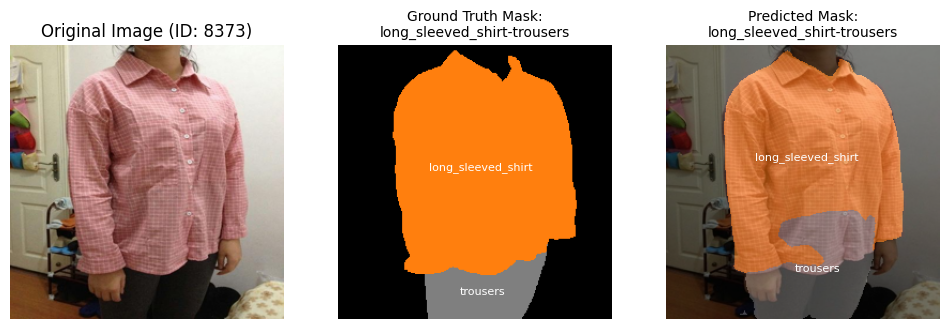

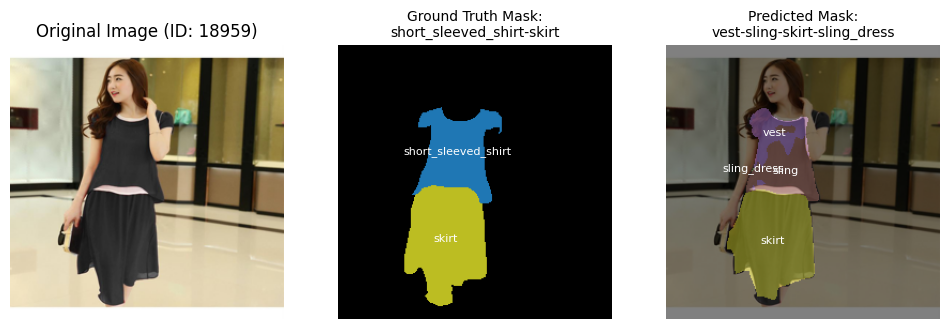

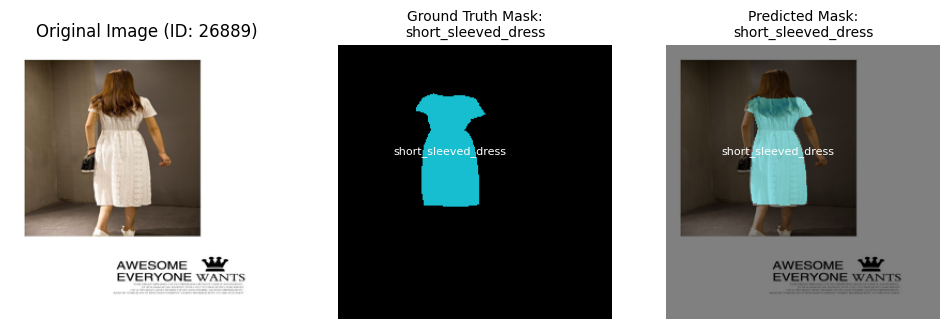

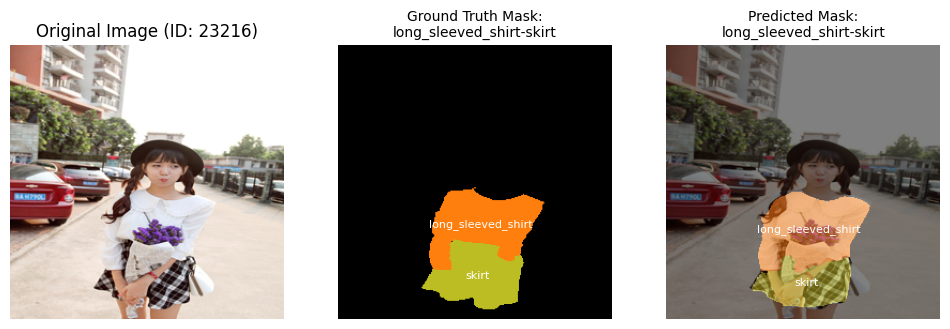

KeyboardInterrupt: 

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import random
import os
from PIL import Image
import segmentation_models_pytorch as smp
from pycocotools.coco import COCO
from pycocotools import mask
from torch.utils.data import Dataset, DataLoader

class DeepFashion2Dataset_val(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None, image_size=(256, 256)):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_filenames = os.listdir(image_dir)
        self.transform = transform
        self.image_size = image_size  # Specify desired image size

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        
        
        img_name = os.path.join(self.image_dir, self.image_filenames[idx])
        mask_name = os.path.join(self.mask_dir, self.image_filenames[idx].replace('.jpg', '.png'))
        import json
        
        
        with open("./datasets/deepfashion2_ann/val_ann/coco_ann/deepfashion2.json") as f:
            annotations = json.load(f)
        image_id = [i['id'] for i in annotations['images'] if i['file_name'] == self.image_filenames[idx]][0]
        # Load image and mask
        image = Image.open(img_name).convert("RGB")
        mask = Image.open(mask_name)

        # Resize both the image and mask to the target size
        image = image.resize(self.image_size)
        mask = mask.resize(self.image_size, Image.NEAREST)  # Use nearest neighbor for mask resizing

        # Convert mask to tensor
        mask = np.array(mask)
        mask = torch.tensor(mask, dtype=torch.long)

        if self.transform:
            image = self.transform(image)

        return image, mask, image_id

def custom_collate_fn(batch):
    """
    Custom collate function to handle batching of image, mask, and metadata.
    
    Args:
        batch (list of tuples): List of tuples from the dataset.
        
    Returns:
        Tuple: Batched images, masks, and metadata.
    """
    images, masks, metadata = zip(*batch)  # Separate images, masks, and metadata
    
    # Stack images and masks into batches
    images = torch.stack(images, dim=0)
    masks = torch.stack(masks, dim=0)

    # Return images, masks, and metadata
    return images, masks, list(metadata)  # Keep metadata as int

device= torch.device("cuda" if torch.cuda.is_available() else "cpu")



model_eval = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=14                    # Number of classes in deepfashion2 +1 for background clas
    # activation="softmax"           # For multi-class segmentation
).to(device)

transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 256x256
    # transforms.RandomHorizontalFlip(p=0.5),  # Random horizontal flip
    transforms.ToTensor(),  # Convert to tensor
    # transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),  # Normalize (for images only)
])

# checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_1plus5plus3plus5plus5plus5_resnet101_march24.pt")
checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_100ep.pt")
model_eval.load_state_dict(checkpoint['model_state_dict'])
# model_eval.load_state_dict(torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_1ep_resnet101_march23.pt"))
# Switch the model to evaluation mode
model_eval.eval()

val_dataset_deeplab = DeepFashion2Dataset_val('./datasets/deepfashion2/images/val/', './datasets/deepfashion2_ann/val_ann/mask/', transform=transform)
val_loader_deeplab = DataLoader(val_dataset_deeplab, shuffle=False, collate_fn=custom_collate_fn)



            
visualize_predictions_for_specific_ids(model_eval, val_loader_deeplab, deepfashion2_classes, device, image_ids_to_plot=[8373, 18959, 26889, 23216, 270], num_samples=5)

In [ ]:
import json

with open("./datasets/deepfashion2_ann/val_ann/coco_ann/deepfashion2.json") as f:
    annotations = json.load(f)

In [12]:
cats = {i['name']: i['id'] for i in annotations['categories']}

In [16]:
cats

{'short_sleeved_shirt': 1,
 'long_sleeved_shirt': 2,
 'short_sleeved_outwear': 3,
 'long_sleeved_outwear': 4,
 'vest': 5,
 'sling': 6,
 'shorts': 7,
 'trousers': 8,
 'skirt': 9,
 'short_sleeved_dress': 10,
 'long_sleeved_dress': 11,
 'vest_dress': 12,
 'sling_dress': 13}

### Model Evaluate 


In [ ]:
import numpy as np
import torch
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
import segmentation_models_pytorch as smp
import os
from PIL import Image
import json
import torch.nn.functional as F


with open("./datasets/deepfashion2_ann/val_ann/coco_ann/deepfashion2.json", "r") as f:
    ann_ = json.load(f)

cat_map = {}
cat_map = {0: "background"}
for cat in ann_['categories']:
    cat_map[cat['id']] = cat['name']
num_classes = len(cat_map) 
del ann_

# Dataset Class for DeepLabV3+
class DeepFashion2Dataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None, image_size=(256, 256)):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_filenames = os.listdir(image_dir)
        self.transform = transform
        self.image_size = image_size

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        img_name = os.path.join(self.image_dir, self.image_filenames[idx])
        mask_name = os.path.join(self.mask_dir, self.image_filenames[idx].replace('.jpg', '.png'))

        image = Image.open(img_name).convert("RGB")
        mask = Image.open(mask_name)

        image = image.resize(self.image_size)
        mask = mask.resize(self.image_size, Image.NEAREST)

        mask = torch.tensor(np.array(mask), dtype=torch.long)
        if self.transform:
            image = self.transform(image)

        return image, mask
# Load Model

transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 256x256
    # transforms.RandomHorizontalFlip(p=0.5),  # Random horizontal flip
    transforms.ToTensor(),  # Convert to tensor
    # transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),  # Normalize (for images only)
])


dir_val = "./datasets/deepfashion2/images/val/"
dir_mask_val = "./datasets/deepfashion2_ann/val_ann/mask/"

# Test DataLoader
val_dataset_deeplab = DeepFashion2Dataset(dir_val, dir_mask_val, transform=transform)
val_loader_deeplab = DataLoader(val_dataset_deeplab, shuffle=False)


num_classes = 14 
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 512x512 recommended by deeplab
    transforms.ToTensor(),
])


# Initialize DeepLabV3+ model with ResNet encoder
modeldeeplabv3plus = smp.DeepLabV3Plus(
    encoder_name="resnet101",        # ResNet101 as the encoder
    encoder_weights="imagenet",    # Use pre-trained weights
    classes=num_classes,                    # Number of classes in Deepfashion2 +1 for background clas
)

checkpoint = torch.load("./fine_tuned_models/deepfashion2/deeplabv3plus/deepfashion2_deeplabv3plus_100ep.pt")
modeldeeplabv3plus.load_state_dict(checkpoint['model_state_dict'])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
modeldeeplabv3plus.eval()
modeldeeplabv3plus.to(device)


precision_by_class = {cls: [] for cls in range(num_classes)}
recall_by_class = {cls: [] for cls in range(num_classes)}


total_tp = {cls: 0 for cls in range(num_classes)}
total_fp = {cls: 0 for cls in range(num_classes)}
total_fn = {cls: 0 for cls in range(num_classes)}
total_iou_sum = {cls: 0.0 for cls in range(num_classes)}
total_iou_count = {cls: 0 for cls in range(num_classes)}

all_tp = 0
all_fp = 0
all_fn = 0
all_iou_sum = 0
all_iou_count = 0
total_pixels = 0

with torch.no_grad():
    for images, gt_mask in val_loader_deeplab:
        images = images.to(device)
        gt_mask = gt_mask.to(device)
        total_pixels += np.prod(gt_mask.shape)  # Total number of pixels in the batch
        # Get predictions
        pred_mask = modeldeeplabv3plus(images)
        probs = F.softmax(pred_mask, dim=1)
        pred_mask = torch.argmax(probs, dim=1).cpu().numpy()
        gt_mask = gt_mask.cpu().numpy()
        
        
        tp_pixels = np.sum(gt_mask == pred_mask)
        all_tp += tp_pixels


        present_classes = set(np.unique(gt_mask)) | set(np.unique(pred_mask))
        for cls in present_classes:  # Only store metrics for present classes
            # ------------------------------------------------------
            
            gt = (gt_mask == cls)
            pred = (pred_mask == cls)
            
            tp = np.logical_and(gt, pred).sum()
            fp = np.logical_and(np.logical_not(gt), pred).sum()
            fn = np.logical_and(gt, np.logical_not(pred)).sum()

            total_tp[cls] += tp
            total_fp[cls] += fp
            total_fn[cls] += fn

            # For IoU averaging
            union = np.logical_or(gt, pred).sum()
            if union > 0:
                iou = tp / union
                total_iou_sum[cls] += iou
                total_iou_count[cls] += 1
            # ------------------------------------------------------
                  
    # ----------------------------------
    final_precision_by_class = {}
    final_recall_by_class = {}
    final_f1_by_class = {}
    final_iou_by_class = {}

    for cls in range(num_classes):
        tp = total_tp[cls]
        fp = total_fp[cls]
        fn = total_fn[cls]

        precision = tp / (tp + fp) if (tp + fp) > 0 else 0.0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0.0
        f1 = 2 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0.0
        iou = total_iou_sum[cls] / total_iou_count[cls] if total_iou_count[cls] > 0 else 0.0

        final_precision_by_class[cat_map[cls]] = precision
        final_recall_by_class[cat_map[cls]] = recall
        final_f1_by_class[cat_map[cls]] = f1
        final_iou_by_class[cat_map[cls]] = iou
    # ------------------------------------
# Compute mAP at IoU thresholds and 0.95

# Filter out None values before applying np.nanmean
def safe_nanmean(values):
    # Remove None values and use np.nanmean on the remaining values
    return np.nanmean([v for v in values if v is not None])


# Print out the results
print("Precision per class:", final_precision_by_class)
print("Recall per class:", final_recall_by_class)
print("F1-score per class:", final_f1_by_class)
print("IoU per class:", final_iou_by_class)

print("\n ------------------------------------ \n")

print("avg precision:", safe_nanmean(list(final_precision_by_class.values())))
print("avg recall:", safe_nanmean(list(final_recall_by_class.values())))
print("mIoU:", safe_nanmean(list(final_iou_by_class.values())))
print("avg f1:", safe_nanmean(list(final_f1_by_class.values())))
print("Pixel accuracy:", all_tp / total_pixels if total_pixels > 0 else 0)
print("\n ------------------------------------ \n")

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/tmp/ipykernel_102451/1155086101.py:81: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start s

Precision per class: {'background': 0.9717224817571171, 'short_sleeved_shirt': 0.8208924988614621, 'long_sleeved_shirt': 0.6916456498210664, 'short_sleeved_outwear': 0.5254944568696045, 'long_sleeved_outwear': 0.7631619968898882, 'vest': 0.6625035639882707, 'sling': 0.5816643106980788, 'shorts': 0.8131291916602256, 'trousers': 0.8428570461238004, 'skirt': 0.8137311953781584, 'short_sleeved_dress': 0.6516593857206731, 'long_sleeved_dress': 0.4408142357725876, 'vest_dress': 0.7190979195878074, 'sling_dress': 0.6564055267692405}
Recall per class: {'background': 0.9881317999608491, 'short_sleeved_shirt': 0.8100892486444844, 'long_sleeved_shirt': 0.7222839005275922, 'short_sleeved_outwear': 0.15406312314761594, 'long_sleeved_outwear': 0.6037117938766128, 'vest': 0.6810734179003476, 'sling': 0.44432979275287793, 'shorts': 0.7122232790590975, 'trousers': 0.8379826627996905, 'skirt': 0.7549655516611149, 'short_sleeved_dress': 0.5705039588632759, 'long_sleeved_dress': 0.5056344470042368, 'vest_

# YOLOv11

## Preprocess data to YOLO format

In [ ]:
import JSON2YOLO.utils
import JSON2YOLO.general_json2yolo
from ultralytics import YOLO

# JSON2YOLO.general_json2yolo.convert_coco_json(json_dir="./datasets/deepfashion2/train/ann_yolo/", use_segments=True)

JSON2YOLO.general_json2yolo.convert_coco_json(json_dir="./datasets/deepfashion2/val/ann_yolo", use_segments=True)

Annotations /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/val/ann_yolo/deepfashion2.json: 100%|██████████| 32153/32153 [00:03<00:00, 8234.34it/s]


### Dataset Configuration

This YAML file specifies the dataset structure and class labels for a model training setup.
<small>
```yaml
# Train/val/test sets as:
# 1) dir: path/to/imgs
# 2) file: path/to/imgs.txt
# 3) list: [path/to/imgs1, path/to/imgs2, ..]

path: "ds_ann"  # Set dataset root directory, the true location is in datasets/ds_ann
train: "images/train"  # Training images (relative to 'path')
val: "images/val"      # Validation images (relative to 'path')
test:                  # Test images (optional)

# Class names ( # no. classes)
names:
  0: "shirt, blouse"
  1: "top, t-shirt, sweatshirt"
  # Add other class names here as needed


### Create category names as id: category name

In [ ]:
import json
with open("instances_attributes_train2020.json") as f:
    annotations = json.load(f)
    
categories = [i['name'] for i in annotations['categories']]
categories_str = '\n'.join(categories)

for i,j in enumerate(categories):
    print(f"{i}: {j}")

### Fine-tuning the YOLOV11 model

##### To train on YOLO, the categortries are expected to start from id 0 

Task: change the category ids as id - 1

In [ ]:
# for i in  range(len(atrain['annotations'])):
#     atrain['annotations'][i]['category_id'] = atrain['annotations'][i]['category_id'] - 1
# for i in  range(len(aval['annotations'])):
#     aval['annotations'][i]['category_id'] = aval['annotations'][i]['category_id'] - 1
    
# for i in range(len(atrain['categories'])):
#     atrain['categories'][i]['id'] = atrain['categories'][i]['id'] - 1
# for i in range(len(aval['categories'])):
#     aval['categories'][i]['id'] = aval['categories'][i]['id'] - 1

In [7]:
!echo $cv2

/bin/bash: -c: line 1: syntax error near unexpected token `newline'
/bin/bash: -c: line 1: `echo <module 'cv2' from '/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/cv2/__init__.py'>'


In [ ]:
# with open('./datasets/deepfashion2/train/ann_yolo/deepfashion2.json', 'w') as json_file:
#     json.dump(atrain, json_file) 
# with open('./datasets/deepfashion2/val/ann_yolo/deepfashion2.json', 'w') as json_file:
#     json.dump(aval, json_file)  # indent=4 for pretty formatting

In [ ]:
import os
import shutil
import glob

# Set your dataset paths
label_dir = './datasets/deepfashion2/labels/train/'
image_dir = '/path/to/images/train'
output_dir = '/path/to/corrupt'  # where corrupt files will be moved

os.makedirs(output_dir + '/labels', exist_ok=True)
os.makedirs(output_dir + '/images', exist_ok=True)

def is_invalid_bbox(parts):
    # YOLO format: class x y w h
    if len(parts) != 5:
        return True
    try:
        _, x, y, w, h = map(float, parts)
        return any(coord < 0.0 or coord > 1.0 for coord in [x, y, w, h])
    except ValueError:
        return True

label_files = glob.glob(os.path.join(label_dir, '*.txt'))
corrupt_files = []

for label_file in label_files:
    with open(label_file, 'r') as f:
        lines = f.readlines()

    if any(is_invalid_bbox(line.strip().split()) for line in lines):
        corrupt_files.append(label_file)
        base = os.path.splitext(os.path.basename(label_file))[0]
        img_file = os.path.join(image_dir, base + '.jpg')

        shutil.move(label_file, os.path.join(output_dir, 'labels', os.path.basename(label_file)))
        if os.path.exists(img_file):
            shutil.move(img_file, os.path.join(output_dir, 'images', os.path.basename(img_file)))

print(f"Moved {len(corrupt_files)} corrupt label files and corresponding images to '{output_dir}'")


In [2]:
import os

label_folder = "./datasets/deepfashion2/labels/train/"
image_folder = "./datasets/deepfashion2/images/train/"
count = 0
for filename in os.listdir(label_folder):
    if filename.endswith(".txt"):
        label_path = os.path.join(label_folder, filename)
        with open(label_path, 'r') as file:
            lines = file.readlines()
            for line in lines:
                parts = line.strip().split()
                try:
                    x_center = float(parts[1])
                    y_center = float(parts[2])
                    width = float(parts[3])
                    height = float(parts[4])
                    # Check if coordinates are out of bounds
                    if not (0 <= x_center <= 1 and 0 <= y_center <= 1 and 0 <= width <= 1 and 0 <= height <= 1):
                        print(f"Warning: Out of bounds in {label_path}: {line}")
                        count += 1
                        
                except ValueError:
                    print(f"Error: Invalid values in {label_path}: {line}")
print(count)


















































































































































































177


In [5]:
import os

def find_corrupt_images(label_folder, image_folder):
    corrupt_images = []
    
    # Iterate through all label files in the given folder
    for filename in os.listdir(label_folder):
        if filename.endswith(".txt"):  # Ensure we are checking label files
            label_path = os.path.join(label_folder, filename)
            image_path = os.path.join(image_folder, filename.replace('.txt', '.jpg'))  # Assuming JPG images
            
            with open(label_path, 'r') as file:
                lines = file.readlines()
                for line in lines:
                    parts = line.strip().split()
                    try:
                        # Extract the bounding box coordinates
                        x_center = float(parts[1])
                        y_center = float(parts[2])
                        width = float(parts[3])
                        height = float(parts[4])

                        # Check if coordinates are within the [0, 1] range
                        if not (0 <= x_center <= 1 and 0 <= y_center <= 1 and 0 <= width <= 1 and 0 <= height <= 1):
                            print(f"Corrupt label: {label_path}")
                            print(f"Corrupt image: {image_path}")
                            corrupt_images.append(image_path)
                            break  # No need to check further for this label file
                    except ValueError:
                        print(f"Error: Invalid values in {label_path}: {line}")
                        corrupt_images.append(image_path)
                        break

    if not corrupt_images:
        print("No corrupt images found.")
    else:
        print(f"Found {len(corrupt_images)} corrupt images/labels.")
    
    return corrupt_images

# Example usage

label_folder = "./datasets/deepfashion2/labels/train/"
image_folder = "./datasets/deepfashion2/images/train/"
corrupt_images = find_corrupt_images(label_folder, image_folder)


Corrupt label: ./datasets/deepfashion2/labels/train/013277.txt
Corrupt image: ./datasets/deepfashion2/images/train/013277.jpg
Corrupt label: ./datasets/deepfashion2/labels/train/098083.txt
Corrupt image: ./datasets/deepfashion2/images/train/098083.jpg
Corrupt label: ./datasets/deepfashion2/labels/train/081054.txt
Corrupt image: ./datasets/deepfashion2/images/train/081054.jpg
Corrupt label: ./datasets/deepfashion2/labels/train/005231.txt
Corrupt image: ./datasets/deepfashion2/images/train/005231.jpg
Corrupt label: ./datasets/deepfashion2/labels/train/095921.txt
Corrupt image: ./datasets/deepfashion2/images/train/095921.jpg
Corrupt label: ./datasets/deepfashion2/labels/train/005090.txt
Corrupt image: ./datasets/deepfashion2/images/train/005090.jpg
Corrupt label: ./datasets/deepfashion2/labels/train/128465.txt
Corrupt image: ./datasets/deepfashion2/images/train/128465.jpg
Corrupt label: ./datasets/deepfashion2/labels/train/086271.txt
Corrupt image: ./datasets/deepfashion2/images/train/086

In [ ]:
corrupt = [ 
"000129.jpg", 
"000151.jpg", 
"000219.jpg", 
"000225.jpg", 
"000237.jpg", 
"000238.jpg", 
"000250.jpg", 
"000305.jpg", 
"000727.jpg", 
"000728.jpg", 
"000973.jpg", 
"001350.jpg", 
"001400.jpg", 
"001469.jpg", 
"001560.jpg", 
"001622.jpg", 
"001705.jpg", 
"001718.jpg", 
"001974.jpg", 
"002066.jpg", 
"002148.jpg", 
"002279.jpg", 
"002384.jpg", 
"002386.jpg", 
"002524.jpg", 
"002629.jpg", 
"003649.jpg", 
"004130.jpg", 
"004362.jpg", 
"004376.jpg", 
"004645.jpg", 
"004694.jpg", 
"004712.jpg", 
"004736.jpg", 
"004786.jpg", 
"004830.jpg", 
"005067.jpg", 
"005236.jpg", 
"005985.jpg", 
"006219.jpg", 
"006597.jpg", 
"006674.jpg", 
"006678.jpg", 
"006719.jpg", 
"006973.jpg", 
"007089.jpg", 
"007126.jpg", 
"007127.jpg", 
"007138.jpg", 
"007181.jpg", 
"007185.jpg", 
"007205.jpg", 
"007294.jpg", 
"007314.jpg", 
"007317.jpg", 
"007580.jpg", 
"008804.jpg", 
"009071.jpg", 
"009081.jpg", 
"009131.jpg", 
"009348.jpg", 
"010551.jpg", 
"010562.jpg", 
"010599.jpg", 
"010848.jpg", 
"010962.jpg", 
"011494.jpg", 
"012074.jpg", 
"012560.jpg", 
"012818.jpg", 
"012820.jpg", 
"012936.jpg", 
"012954.jpg", 
"012970.jpg", 
"013138.jpg", 
"013261.jpg", 
"013443.jpg", 
"013632.jpg", 
"013918.jpg", 
"014200.jpg", 
"015138.jpg", 
"015392.jpg", 
"015941.jpg", 
"015943.jpg", 
"018926.jpg", 
"022150.jpg", 
"022192.jpg", 
"028900.jpg", 
"029213.jpg", 
"031036.jpg", 
"032220.jpg", 
"032268.jpg", 
"032407.jpg", 
"032443.jpg", 
"032700.jpg", 
"032752.jpg", 
"032953.jpg", 
"032957.jpg", 
"033193.jpg", 
"033269.jpg", 
"033271.jpg", 
"033456.jpg", 
"033457.jpg", 
"033489.jpg", 
"034061.jpg", 
"034062.jpg", 
"034063.jpg", 
"034066.jpg", 
"034094.jpg", 
"034328.jpg", 
"035206.jpg", 
"035209.jpg", 
"035304.jpg", 
"035928.jpg", 
"035970.jpg", 
"036782.jpg", 
"036927.jpg", 
"038349.jpg", 
"038471.jpg", 
"039321.jpg", 
"039402.jpg", 
"039731.jpg", 
"039764.jpg", 
"040040.jpg", 
"040334.jpg", 
"040717.jpg", 
"040957.jpg", 
"041083.jpg", 
"041086.jpg", 
"041169.jpg", 
"041385.jpg", 
"042377.jpg", 
"042790.jpg", 
"042857.jpg", 
"043374.jpg", 
"043541.jpg", 
"043895.jpg", 
"044027.jpg", 
"044031.jpg", 
"044283.jpg", 
"044497.jpg", 
"045592.jpg", 
"045622.jpg", 
"045665.jpg", 
"045705.jpg", 
"045867.jpg", 
"046711.jpg", 
"047144.jpg", 
"047225.jpg", 
"047233.jpg", 
"047373.jpg", 
"047864.jpg", 
"047927.jpg", 
"048019.jpg", 
"048172.jpg", 
"048175.jpg", 
"048176.jpg", 
"048949.jpg", 
"049355.jpg", 
"049767.jpg", 
"049780.jpg", 
"049794.jpg", 
"049850.jpg", 
"049933.jpg", 
"050150.jpg", 
"050634.jpg", 
"050887.jpg", 
"051107.jpg", 
"051333.jpg", 
"051380.jpg", 
"051635.jpg", 
"051671.jpg", 
"051768.jpg", 
"051776.jpg", 
"051777.jpg", 
"051778.jpg", 
"051957.jpg", 
"052055.jpg", 
"052269.jpg", 
"052397.jpg", 
"052406.jpg", 
"052518.jpg", 
"052543.jpg", 
"053133.jpg", 
"054005.jpg", 
"054026.jpg", 
"054080.jpg", 
"054314.jpg", 
"054420.jpg", 
"054588.jpg", 
"054723.jpg", 
"054832.jpg", 
"054960.jpg", 
"054991.jpg", 
"055023.jpg", 
"055133.jpg", 
"055195.jpg", 
"055212.jpg", 
"055537.jpg", 
"055772.jpg", 
"055776.jpg", 
"055781.jpg", 
"056078.jpg", 
"056244.jpg", 
"056545.jpg", 
"056638.jpg", 
"056828.jpg", 
"057185.jpg", 
"057229.jpg", 
"057357.jpg", 
"057620.jpg", 
"059312.jpg", 
"059313.jpg", 
"059357.jpg", 
"059703.jpg", 
"059754.jpg", 
"059943.jpg", 
"060181.jpg", 
"060188.jpg", 
"060384.jpg", 
"060560.jpg", 
"060598.jpg", 
"061775.jpg", 
"062216.jpg", 
"062561.jpg", 
"063812.jpg", 
"064075.jpg", 
"064738.jpg", 
"064962.jpg", 
"065065.jpg", 
"065121.jpg", 
"065488.jpg", 
"065667.jpg", 
"065682.jpg", 
"065916.jpg", 
"065953.jpg", 
"066158.jpg", 
"066249.jpg", 
"066406.jpg", 
"066524.jpg", 
"066700.jpg", 
"066701.jpg", 
"066747.jpg", 
"066946.jpg", 
"067095.jpg", 
"067206.jpg", 
"067447.jpg", 
"067546.jpg", 
"067595.jpg", 
"068036.jpg", 
"068047.jpg", 
"068361.jpg", 
"068667.jpg", 
"068737.jpg", 
"068860.jpg", 
"069088.jpg", 
"069124.jpg", 
"069137.jpg", 
"069176.jpg", 
"069224.jpg", 
"069454.jpg", 
"069829.jpg", 
"069899.jpg", 
"069968.jpg", 
"070352.jpg", 
"070705.jpg", 
"070722.jpg", 
"070741.jpg", 
"070809.jpg", 
"070831.jpg", 
"070960.jpg", 
"070971.jpg", 
"071021.jpg", 
"071154.jpg", 
"071156.jpg", 
"071468.jpg", 
"071699.jpg", 
"071986.jpg", 
"072094.jpg", 
"072232.jpg", 
"072718.jpg", 
"072783.jpg", 
"073281.jpg", 
"074023.jpg", 
"074028.jpg", 
"074393.jpg", 
"074934.jpg", 
"075010.jpg", 
"075117.jpg", 
"075297.jpg", 
"075352.jpg", 
"075368.jpg", 
"075576.jpg", 
"075641.jpg", 
"075819.jpg", 
"075852.jpg", 
"075893.jpg", 
"075926.jpg", 
"076056.jpg", 
"076081.jpg", 
"076103.jpg", 
"076153.jpg", 
"078521.jpg", 
"079821.jpg", 
"079873.jpg", 
"080210.jpg", 
"080526.jpg", 
"081054.jpg", 
"081074.jpg", 
"081192.jpg", 
"081263.jpg", 
"081385.jpg", 
"081810.jpg", 
"082170.jpg", 
"082207.jpg", 
"082261.jpg", 
"082407.jpg", 
"083975.jpg", 
"083979.jpg", 
"083985.jpg", 
"084080.jpg", 
"084629.jpg", 
"084717.jpg", 
"084796.jpg", 
"084988.jpg", 
"085297.jpg", 
"085345.jpg", 
"085366.jpg", 
"085647.jpg", 
"085732.jpg", 
"085762.jpg", 
"086258.jpg", 
"086259.jpg", 
"086275.jpg", 
"086279.jpg", 
"086282.jpg", 
"086425.jpg", 
"086534.jpg", 
"086610.jpg", 
"086905.jpg", 
"087174.jpg", 
"087362.jpg", 
"087505.jpg", 
"087538.jpg", 
"087559.jpg", 
"087686.jpg", 
"088757.jpg", 
"089085.jpg", 
"089651.jpg", 
"089991.jpg", 
"090302.jpg", 
"090381.jpg", 
"090539.jpg", 
"092722.jpg", 
"094094.jpg", 
"094186.jpg", 
"094489.jpg", 
"094490.jpg", 
"094643.jpg", 
"094655.jpg", 
"094741.jpg", 
"094747.jpg", 
"095511.jpg", 
"095527.jpg", 
"095742.jpg", 
"095745.jpg", 
"096135.jpg", 
"097506.jpg", 
"097510.jpg", 
"097516.jpg", 
"097517.jpg", 
"097843.jpg", 
"098089.jpg", 
"098195.jpg", 
"098203.jpg", 
"098465.jpg", 
"098689.jpg", 
"098692.jpg", 
"098916.jpg", 
"100008.jpg", 
"100014.jpg", 
"100018.jpg", 
"100090.jpg", 
"100371.jpg", 
"102295.jpg", 
"103565.jpg", 
"103567.jpg", 
"103573.jpg", 
"103580.jpg", 
"103753.jpg", 
"103836.jpg", 
"103909.jpg", 
"103977.jpg", 
"104120.jpg", 
"104219.jpg", 
"104785.jpg", 
"104972.jpg", 
"105021.jpg", 
"105311.jpg", 
"105514.jpg", 
"105518.jpg", 
"105519.jpg", 
"105816.jpg", 
"105871.jpg", 
"106154.jpg", 
"106744.jpg", 
"106957.jpg", 
"106964.jpg", 
"107802.jpg", 
"107906.jpg", 
"108134.jpg", 
"108870.jpg", 
"109466.jpg", 
"110008.jpg", 
"110168.jpg", 
"110466.jpg", 
"110558.jpg", 
"110889.jpg", 
"111611.jpg", 
"111977.jpg", 
"113285.jpg", 
"113289.jpg", 
"114229.jpg", 
"114601.jpg", 
"117159.jpg", 
"117667.jpg", 
"117988.jpg", 
"119154.jpg", 
"119156.jpg", 
"119160.jpg", 
"119964.jpg", 
"120423.jpg", 
"120452.jpg", 
"120606.jpg", 
"120720.jpg", 
"120773.jpg", 
"121200.jpg", 
"121487.jpg", 
"121488.jpg", 
"122530.jpg", 
"122533.jpg", 
"122800.jpg", 
"123459.jpg", 
"123883.jpg", 
"124261.jpg", 
"124298.jpg", 
"124990.jpg", 
"124992.jpg", 
"125160.jpg", 
"126156.jpg", 
"126445.jpg", 
"126468.jpg", 
"126539.jpg", 
"126719.jpg", 
"126793.jpg", 
"126945.jpg", 
"127224.jpg", 
"127769.jpg", 
"128038.jpg", 
"128075.jpg", 
"128370.jpg", 
"128506.jpg", 
"128562.jpg", 
"128671.jpg", 
"128822.jpg", 
"129569.jpg", 
"129617.jpg", 
"129881.jpg", 
"130257.jpg", 
"130488.jpg", 
"130886.jpg", 
"130890.jpg", 
"131160.jpg", 
"131301.jpg", 
"131753.jpg", 
"132094.jpg", 
"132215.jpg", 
"132585.jpg", 
"132989.jpg", 
"132992.jpg", 
"133070.jpg", 
"133634.jpg", 
"134014.jpg", 
"134537.jpg", 
"134678.jpg", 
"134849.jpg", 
"135053.jpg", 
"135216.jpg", 
"135618.jpg", 
"135674.jpg", 
"135842.jpg", 
"135843.jpg", 
"136327.jpg", 
"136328.jpg", 
"136332.jpg", 
"136720.jpg", 
"136721.jpg", 
"136727.jpg", 
"136781.jpg", 
"136784.jpg", 
"136822.jpg", 
"136937.jpg", 
"136944.jpg", 
"137799.jpg", 
"138279.jpg", 
"141098.jpg", 
"141153.jpg", 
"141183.jpg", 
"142757.jpg", 
"143921.jpg", 
"143922.jpg", 
"144135.jpg", 
"144343.jpg", 
"144389.jpg", 
"144532.jpg", 
"145347.jpg", 
"145536.jpg", 
"145557.jpg", 
"146770.jpg", 
"146869.jpg", 
"146946.jpg", 
"148051.jpg", 
"148203.jpg", 
"148219.jpg", 
"148408.jpg", 
"148550.jpg", 
"149158.jpg", 
"149537.jpg", 
"149791.jpg", 
"149992.jpg", 
"150505.jpg", 
"150772.jpg", 
"151038.jpg", 
"151195.jpg", 
"151518.jpg", 
"151765.jpg", 
"152395.jpg", 
"152678.jpg", 
"152685.jpg", 
"152694.jpg", 
"152834.jpg", 
"152949.jpg", 
"153010.jpg", 
"153039.jpg", 
"153043.jpg", 
"153112.jpg", 
"153134.jpg", 
"153387.jpg", 
"153732.jpg", 
"154119.jpg", 
"154238.jpg", 
"154526.jpg", 
"154895.jpg", 
"155164.jpg", 
"155293.jpg", 
"155448.jpg", 
"157090.jpg", 
"157193.jpg", 
"159233.jpg", 
"159335.jpg", 
"160553.jpg", 
"160770.jpg", 
"161076.jpg", 
"161346.jpg", 
"161373.jpg", 
"162542.jpg", 
"162892.jpg", 
"162893.jpg", 
"163395.jpg", 
"164121.jpg", 
"164702.jpg", 
"166160.jpg", 
"167343.jpg", 
"167659.jpg", 
"170140.jpg", 
"170953.jpg", 
"173637.jpg", 
"174580.jpg", 
"175142.jpg", 
"175603.jpg", 
"175615.jpg", 
"176781.jpg", 
"177443.jpg", 
"177566.jpg", 
"177611.jpg", 
"177784.jpg", 
"177940.jpg", 
"178725.jpg", 
"179268.jpg", 
"180524.jpg", 
"180611.jpg", 
"181959.jpg", 
"182427.jpg", 
"182556.jpg", 
"183626.jpg", 
"183698.jpg", 
"183713.jpg", 
"184469.jpg", 
"184666.jpg", 
"185381.jpg", 
"185402.jpg", 
"185969.jpg", 
"186074.jpg", 
"186823.jpg", 
"187302.jpg", 
"188968.jpg", 
"189487.jpg", 
"190246.jpg", 
"190747.jpg"
]

label_folder = "./datasets/deepfashion2_modified/labels/train/"
image_folder = "./datasets/deepfashion2_modified/images/train/"
for i in corrupt:
    os.remove(os.path.join(label_folder, i.replace(".jpg", ".txt")))
    os.remove(os.path.join(image_folder, i))

In [9]:
import os

label_folder = "./datasets/deepfashion2_modified/labels/val/"
image_folder = "./datasets/deepfashion2_modified/images/val/"

def remove_zone_identifier_files(folder):
    for f in os.listdir(folder):
        if "Zone.Identifier" in f:
            path = os.path.join(folder, f)
            os.remove(path)
            print(f"Removed: {path}")

remove_zone_identifier_files(label_folder)
remove_zone_identifier_files(image_folder)


Removed: ./datasets/deepfashion2_modified/labels/val/006382.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/001295.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/012387.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/007691.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/009155.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/002799.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/010015.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/026914.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/028686.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/009984.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/020831.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modified/labels/val/026275.txt:Zone.Identifier
Removed: ./datasets/deepfashion2_modifie

### Training YOLOv11

In [1]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  


# Load a model
model = YOLO("./yolo_models/yolo11n-seg.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", epochs=200,lr0=1e-4, optimizer="AdamW")

New https://pypi.org/project/ultralytics/8.3.99 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=./yolo_models/yolo11n-seg.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, clas

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


Overriding model.yaml nc=80 with nc=13

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytic

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/200      3.19G     0.8833      3.131      1.867      1.187         35        640: 100%|██████████| 11960/11960 [54:48<00:00,  3.64it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:52<00:00,  3.43it/s]


                   all      32153      52490      0.648      0.531      0.541      0.438      0.514      0.392      0.371      0.223

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/200      3.25G     0.7847       2.83      1.451      1.115         56        640:  14%|█▍        | 1648/11960 [06:38<41:31,  4.14it/s]  
Exception in thread Thread-8 (_pin_memory_loop):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/torch/utils/data/_utils/pin_memory.py", line 59, in _pin_memory_loop
    do_one_step()
  File "/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/torch/utils/data/_utils/pin_memory.py", line 35, in do_one_step
    r = in_queue.get(timeout=MP_STATUS_CHECK_INTERVAL)
  File "/usr/lib/python3.10/multiprocessing/queues.py", line 122, in get
    return _ForkingPickler.loads(res)
  File "/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/torch/multiprocessing/reductions.py",

KeyboardInterrupt: 

In [ ]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  


# Load a model
model = YOLO("./runs/segment/train65/weights/last.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", resume=True)

New https://pypi.org/project/ultralytics/8.3.99 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=runs/segment/train65/weights/last.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs/segment/train65/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, 

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


TensorBoard: Start with 'tensorboard --logdir runs/segment/train65', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Resuming training runs/segment/train65/weights/last.pt from epoch 2 to 200 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/200       3.2G     0.7548      2.708      1.337      1.104         35        640: 100%|██████████| 11960/11960 [46:55<00:00,  4.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:28<00:00,  3.75it/s]


                   all      32153      52490      0.733      0.586       0.63      0.532      0.592      0.449      0.466      0.296

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/200      3.17G     0.7104      2.554      1.185      1.072         31        640: 100%|██████████| 11960/11960 [49:31<00:00,  4.02it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:23<00:00,  3.82it/s]


                   all      32153      52490      0.763      0.602      0.664      0.568      0.624      0.461      0.499      0.323

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/200      3.15G     0.6843       2.46      1.101      1.053         40        640: 100%|██████████| 11960/11960 [51:01<00:00,  3.91it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:29<00:00,  3.72it/s]


                   all      32153      52490      0.729      0.641      0.685       0.59      0.588      0.504       0.52      0.339

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/200      3.17G     0.6689      2.407      1.055      1.044         36        640: 100%|██████████| 11960/11960 [50:15<00:00,  3.97it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:20<00:00,  3.86it/s]


                   all      32153      52490      0.722      0.667        0.7      0.605      0.577       0.53      0.534       0.35

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/200      3.14G     0.6595      2.363      1.022      1.036         31        640: 100%|██████████| 11960/11960 [48:34<00:00,  4.10it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:24<00:00,  3.81it/s]


                   all      32153      52490      0.736      0.668      0.713      0.617      0.592      0.532      0.546      0.359

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/200      3.33G     0.6503      2.335     0.9986      1.032         40        640: 100%|██████████| 11960/11960 [48:08<00:00,  4.14it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:19<00:00,  3.88it/s]


                   all      32153      52490      0.756      0.672      0.725       0.63      0.609      0.531      0.556      0.366

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/200      3.15G     0.6439      2.312     0.9807      1.028         30        640: 100%|██████████| 11960/11960 [47:39<00:00,  4.18it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:19<00:00,  3.87it/s]


                   all      32153      52490      0.772      0.667      0.736      0.641      0.622      0.528      0.566      0.374

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/200      3.34G     0.6389      2.293     0.9654      1.024         38        640: 100%|██████████| 11960/11960 [47:23<00:00,  4.21it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:18<00:00,  3.89it/s]


                   all      32153      52490        0.7      0.699      0.748      0.652      0.557      0.555      0.576       0.38

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/200      3.12G     0.6338      2.278     0.9546      1.021         67        640:  16%|█▌        | 1895/11960 [07:20<42:53,  3.91it/s]  

In [ ]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  


# Load a model
model = YOLO("./runs/segment/train65/weights/last.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", resume=True)

New https://pypi.org/project/ultralytics/8.3.99 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=runs/segment/train65/weights/last.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs/segment/train65/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, 

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


TensorBoard: Start with 'tensorboard --logdir runs/segment/train65', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Resuming training runs/segment/train65/weights/last.pt from epoch 11 to 200 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/200       3.2G     0.6402      2.292     0.9782      1.026         35        640: 100%|██████████| 11960/11960 [41:24<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:11<00:00,  3.99it/s]


                   all      32153      52490      0.694      0.715      0.756       0.66      0.552      0.566      0.583      0.383

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/200      3.14G     0.6401       2.29       0.97      1.025         31        640: 100%|██████████| 11960/11960 [43:25<00:00,  4.59it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:05<00:00,  4.10it/s]


                   all      32153      52490      0.701      0.715      0.761      0.664      0.551      0.572      0.587      0.385

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/200      3.37G     0.6354      2.271     0.9547      1.022         40        640: 100%|██████████| 11960/11960 [44:57<00:00,  4.43it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:10<00:00,  4.01it/s]


                   all      32153      52490      0.699      0.734      0.767       0.67      0.549      0.589      0.592      0.388

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/200      3.14G     0.6301      2.255     0.9438       1.02         36        640: 100%|██████████| 11960/11960 [44:36<00:00,  4.47it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:12<00:00,  3.98it/s]


                   all      32153      52490      0.714      0.736      0.772      0.675      0.572      0.586      0.597       0.39

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/200      3.13G     0.6271      2.236     0.9317      1.017         31        640: 100%|██████████| 11960/11960 [44:57<00:00,  4.43it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:19<00:00,  3.88it/s]


                   all      32153      52490      0.733      0.729      0.777      0.679      0.584      0.582      0.601      0.392

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/200      3.33G     0.6237      2.227     0.9236      1.016         40        640: 100%|██████████| 11960/11960 [45:26<00:00,  4.39it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:13<00:00,  3.96it/s]


                   all      32153      52490       0.74      0.728       0.78      0.683      0.594      0.579      0.604      0.395

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/200      3.15G     0.6208      2.222     0.9167      1.014         30        640: 100%|██████████| 11960/11960 [44:39<00:00,  4.46it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:13<00:00,  3.97it/s]


                   all      32153      52490       0.74       0.73      0.783      0.686      0.594      0.582      0.606      0.397

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/200      3.13G     0.6198      2.215     0.9103      1.013         38        640: 100%|██████████| 11960/11960 [44:01<00:00,  4.53it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:14<00:00,  3.94it/s]


                   all      32153      52490      0.747       0.73      0.787       0.69        0.6       0.58       0.61        0.4

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/200      3.13G     0.6171      2.206     0.9053      1.012         38        640: 100%|██████████| 11960/11960 [45:42<00:00,  4.36it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [05:16<00:00,  3.18it/s] 


                   all      32153      52490      0.746       0.74       0.79      0.693        0.6      0.589      0.613      0.403

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/200      3.15G     0.6151      2.191     0.8944      1.009         58        640:  17%|█▋        | 2050/11960 [07:19<39:41,  4.16it/s]

In [ ]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  


# Load a model
model = YOLO("./runs/segment/train65/weights/last.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", resume=True)

New https://pypi.org/project/ultralytics/8.3.99 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=runs/segment/train65/weights/last.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs/segment/train65/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, 

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


TensorBoard: Start with 'tensorboard --logdir runs/segment/train65', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Resuming training runs/segment/train65/weights/last.pt from epoch 20 to 200 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/200       3.2G     0.6147      2.184     0.9024      1.011         35        640: 100%|██████████| 11960/11960 [43:31<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:21<00:00,  3.85it/s]


                   all      32153      52490      0.751      0.737       0.79      0.693      0.603      0.587      0.613      0.402

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/200      3.13G     0.6152      2.186      0.901       1.01         31        640: 100%|██████████| 11960/11960 [44:32<00:00,  4.48it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:10<00:00,  4.00it/s]


                   all      32153      52490      0.749      0.739      0.791      0.695      0.599       0.59      0.613      0.402

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/200      3.37G     0.6142      2.179      0.894      1.009         40        640: 100%|██████████| 11960/11960 [45:07<00:00,  4.42it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:11<00:00,  3.99it/s]


                   all      32153      52490      0.749      0.742      0.793      0.696      0.601      0.591      0.614      0.403

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/200      3.13G     0.6111      2.172     0.8897      1.009         36        640: 100%|██████████| 11960/11960 [45:06<00:00,  4.42it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:12<00:00,  3.97it/s]


                   all      32153      52490      0.747      0.751      0.794      0.697        0.6      0.598      0.616      0.404

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/200      3.13G     0.6098      2.164     0.8837      1.006         31        640: 100%|██████████| 11960/11960 [44:56<00:00,  4.43it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:11<00:00,  4.00it/s]


                   all      32153      52490       0.75       0.75      0.795      0.699        0.6        0.6      0.618      0.405

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/200      3.32G     0.6084       2.16     0.8804      1.007         40        640: 100%|██████████| 11960/11960 [45:17<00:00,  4.40it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:12<00:00,  3.98it/s]


                   all      32153      52490      0.761      0.743      0.796      0.699      0.612      0.595      0.618      0.405

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/200      3.15G     0.6078      2.162     0.8779      1.006         30        640: 100%|██████████| 11960/11960 [45:20<00:00,  4.40it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:10<00:00,  4.02it/s]


                   all      32153      52490      0.758      0.746      0.797        0.7      0.609      0.596      0.619      0.406

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/200      3.13G     0.6073      2.157     0.8742      1.005         62        640:  42%|████▏     | 4965/11960 [21:20<56:32,  2.06it/s]  

In [1]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          
# Load a model
model = YOLO("./runs/segment/train65/weights/last.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", resume=True)

New https://pypi.org/project/ultralytics/8.3.100 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=runs/segment/train65/weights/last.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs/segment/train65/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False,

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


TensorBoard: Start with 'tensorboard --logdir runs/segment/train65', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Resuming training runs/segment/train65/weights/last.pt from epoch 27 to 200 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/200       3.2G     0.6014      2.118     0.8652      1.003         35        640: 100%|██████████| 11960/11960 [44:19<00:00,  4.50it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:24<00:00,  3.80it/s]


                   all      32153      52490      0.763      0.743      0.797        0.7      0.612      0.595      0.619      0.406

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/200      3.13G     0.6045      2.128     0.8706      1.004         31        640: 100%|██████████| 11960/11960 [46:35<00:00,  4.28it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:15<00:00,  3.93it/s]


                   all      32153      52490       0.77      0.739      0.798      0.701      0.621       0.59      0.621      0.407

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/200      3.36G     0.6048      2.129     0.8668      1.004         40        640: 100%|██████████| 11960/11960 [46:22<00:00,  4.30it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:18<00:00,  3.88it/s]


                   all      32153      52490       0.77      0.739      0.799      0.702      0.622      0.591      0.622      0.408

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/200      3.13G     0.6031      2.129     0.8666      1.004         36        640: 100%|██████████| 11960/11960 [47:17<00:00,  4.22it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:19<00:00,  3.87it/s]


                   all      32153      52490      0.767      0.743        0.8      0.703      0.618      0.593      0.623      0.409

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/200      3.13G     0.6029      2.126     0.8637      1.002         31        640: 100%|██████████| 11960/11960 [46:40<00:00,  4.27it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:20<00:00,  3.86it/s]


                   all      32153      52490       0.77      0.741        0.8      0.703      0.622       0.59      0.623       0.41

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/200      3.32G     0.6025       2.13     0.8634      1.003         40        640: 100%|██████████| 11960/11960 [46:10<00:00,  4.32it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:20<00:00,  3.85it/s]


                   all      32153      52490      0.761      0.749        0.8      0.704      0.612        0.6      0.623       0.41

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/200      3.15G     0.6029      2.139     0.8637      1.003         30        640: 100%|██████████| 11960/11960 [46:34<00:00,  4.28it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:19<00:00,  3.87it/s]


                   all      32153      52490      0.767      0.747      0.801      0.705      0.616      0.597      0.624      0.411

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/200      3.13G     0.6029      2.141     0.8629      1.003         38        640: 100%|██████████| 11960/11960 [46:46<00:00,  4.26it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:21<00:00,  3.84it/s]


                   all      32153      52490      0.774      0.741      0.803      0.707      0.623      0.592      0.626      0.412

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/200      3.13G     0.6017      2.139     0.8615      1.002         38        640: 100%|██████████| 11960/11960 [46:08<00:00,  4.32it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:20<00:00,  3.85it/s]


                   all      32153      52490      0.769      0.745      0.804      0.708      0.609      0.606      0.626      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/200      3.15G     0.6012      2.133     0.8583      1.001         28        640: 100%|██████████| 11960/11960 [45:56<00:00,  4.34it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:24<00:00,  3.80it/s]


                   all      32153      52490      0.771      0.745      0.805       0.71      0.622      0.595      0.627      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/200      3.17G        0.6      2.133     0.8551      1.001         28        640: 100%|██████████| 11960/11960 [46:00<00:00,  4.33it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:20<00:00,  3.86it/s]


                   all      32153      52490      0.774      0.746      0.808      0.713      0.615      0.604      0.629      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/200      3.17G     0.5978      2.117     0.8481     0.9997         29        640: 100%|██████████| 11960/11960 [49:56<00:00,  3.99it/s]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:16<00:00,  3.92it/s]


                   all      32153      52490      0.767      0.755      0.808      0.713      0.621      0.602       0.63      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/200      3.31G      0.597      2.119     0.8471     0.9988         24        640: 100%|██████████| 11960/11960 [46:14<00:00,  4.31it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:16<00:00,  3.92it/s]


                   all      32153      52490      0.765      0.758       0.81      0.714      0.616      0.608      0.631      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/200      3.36G      0.596      2.112     0.8434     0.9984         33        640: 100%|██████████| 11960/11960 [46:24<00:00,  4.30it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:23<00:00,  3.81it/s]


                   all      32153      52490      0.762      0.764      0.811      0.716      0.613      0.614      0.632      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/200      3.14G     0.5969      2.098     0.8328     0.9971         68        640:   5%|▌         | 639/11960 [02:33<2:49:19,  1.11it/s]

: 

In [1]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          
# Load a model
model = YOLO("./runs/segment/train65/weights/last.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", resume=True)

New https://pypi.org/project/ultralytics/8.3.100 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=runs/segment/train65/weights/last.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs/segment/train65/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False,

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


TensorBoard: Start with 'tensorboard --logdir runs/segment/train65', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Resuming training runs/segment/train65/weights/last.pt from epoch 41 to 200 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/200       3.2G     0.5887      2.064     0.8266     0.9945         35        640: 100%|██████████| 11960/11960 [42:30<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:15<00:00,  3.93it/s]


                   all      32153      52490      0.769      0.754       0.81      0.715      0.621      0.604      0.632      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/200      3.12G     0.5907      2.069     0.8302     0.9958         31        640: 100%|██████████| 11960/11960 [45:15<00:00,  4.40it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:22<00:00,  3.82it/s]


                   all      32153      52490      0.776      0.749      0.811      0.716      0.627      0.599      0.632      0.417

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/200      3.36G     0.5911      2.068      0.828     0.9955         40        640: 100%|██████████| 11960/11960 [47:07<00:00,  4.23it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:18<00:00,  3.89it/s]


                   all      32153      52490      0.767       0.76      0.811      0.716      0.617      0.609      0.633      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/200      3.13G     0.5894      2.068     0.8281     0.9957         36        640: 100%|██████████| 11960/11960 [48:03<00:00,  4.15it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:14<00:00,  3.95it/s]


                   all      32153      52490      0.782      0.746      0.811      0.716       0.63      0.598      0.633      0.417

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/200      3.12G     0.5891      2.063     0.8271     0.9943         63        640:  66%|██████▌   | 7848/11960 [30:46<16:07,  4.25it/s]  


KeyboardInterrupt: 

In [1]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          
# Load a model
model = YOLO("./runs/segment/train65/weights/last.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", resume=True)

New https://pypi.org/project/ultralytics/8.3.101 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=runs/segment/train65/weights/last.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs/segment/train65/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False,

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


TensorBoard: Start with 'tensorboard --logdir runs/segment/train65', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Resuming training runs/segment/train65/weights/last.pt from epoch 45 to 200 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/200       3.2G     0.5814       2.01     0.8075     0.9909         35        640: 100%|██████████| 11960/11960 [47:22<00:00,  4.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:18<00:00,  3.89it/s]


                   all      32153      52490      0.781      0.744       0.81      0.715       0.63      0.597      0.632      0.417

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/200      3.12G     0.5863      2.034     0.8184     0.9936         31        640: 100%|██████████| 11960/11960 [46:54<00:00,  4.25it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:11<00:00,  3.99it/s]


                   all      32153      52490      0.786       0.74       0.81      0.715      0.633      0.594      0.631      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/200      3.36G     0.5886      2.048     0.8213     0.9941         40        640: 100%|██████████| 11960/11960 [45:55<00:00,  4.34it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:09<00:00,  4.03it/s]


                   all      32153      52490      0.785      0.741       0.81      0.715      0.634      0.594      0.631      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/200      3.13G      0.586      2.044     0.8271     0.9952         68        640:  20%|█▉        | 2380/11960 [09:01<36:20,  4.39it/s]  


KeyboardInterrupt: 

In [1]:
from ultralytics import YOLO
import torch 

torch.set_flush_denormal(True)  

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          
# Load a model
model = YOLO("./runs/segment/train65/weights/last.pt")  # load a pretrained model (recommended for training)

# Train the model
# results = model.train(data="yolo_data.yaml", epochs=100, imgsz=640)
results = model.train(data="./yolo_yaml_data/deepfashion2/yolo_data.yaml", resume=True)

New https://pypi.org/project/ultralytics/8.3.102 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
engine/trainer: task=segment, mode=train, model=runs/segment/train65/weights/last.pt, data=./yolo_yaml_data/deepfashion2/yolo_data.yaml, epochs=200, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train65, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=runs/segment/train65/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False,

/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:518: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/home/linda/opencv-cuda/src/cuda-env/lib/python3.10/site-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


TensorBoard: Start with 'tensorboard --logdir runs/segment/train65', view at http://localhost:6006/

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True

train: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/train.cache... 191961 images, 0 backgrounds, 609 corrupt: 100%|██████████| 191961/191961 [00:00<?, ?it/s]

train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000129.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0011]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000151.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [          1]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000219.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0013]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000225.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0004]
train: WARNING ⚠️ /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/images/train/000237.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [   


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]


Plotting labels to runs/segment/train65/labels.jpg... 
optimizer: AdamW(lr=0.0001, momentum=0.937) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
Resuming training runs/segment/train65/weights/last.pt from epoch 48 to 200 total epochs
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/segment/train65
Starting training for 200 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/200       3.2G      0.577      1.971      0.796     0.9885         35        640: 100%|██████████| 11960/11960 [41:27<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:06<00:00,  4.08it/s]


                   all      32153      52490      0.785      0.739      0.809      0.713      0.626        0.6       0.63      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/200      3.12G     0.5839      2.014      0.812     0.9923         31        640: 100%|██████████| 11960/11960 [42:16<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [03:59<00:00,  4.19it/s]


                   all      32153      52490      0.778      0.748      0.808      0.713      0.629        0.6       0.63      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/200      3.36G     0.5881      2.043     0.8193     0.9938         40        640: 100%|██████████| 11960/11960 [42:59<00:00,  4.64it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:01<00:00,  4.17it/s]


                   all      32153      52490      0.777      0.747      0.808      0.713       0.63      0.596      0.629      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/200      3.13G     0.5885      2.062     0.8247     0.9951         36        640: 100%|██████████| 11960/11960 [42:42<00:00,  4.67it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:00<00:00,  4.18it/s]


                   all      32153      52490      0.771      0.751      0.808      0.712      0.616      0.607      0.629      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/200      3.12G     0.5888      2.063     0.8236      0.994         31        640: 100%|██████████| 11960/11960 [43:12<00:00,  4.61it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:03<00:00,  4.13it/s]


                   all      32153      52490      0.776      0.745      0.807      0.712      0.623        0.6      0.629      0.413

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/200      3.32G     0.5886      2.062     0.8224     0.9947         40        640: 100%|██████████| 11960/11960 [43:27<00:00,  4.59it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [03:58<00:00,  4.21it/s]


                   all      32153      52490      0.771       0.75      0.808      0.713      0.619      0.605      0.629      0.414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/200      3.15G     0.5884      2.068     0.8217     0.9942         30        640: 100%|██████████| 11960/11960 [43:40<00:00,  4.56it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [03:58<00:00,  4.21it/s]


                   all      32153      52490      0.773      0.748      0.808      0.714      0.625      0.599       0.63      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/200      3.12G     0.5886      2.068     0.8212     0.9941         38        640: 100%|██████████| 11960/11960 [43:35<00:00,  4.57it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:01<00:00,  4.16it/s]


                   all      32153      52490      0.766      0.755      0.809      0.714      0.619      0.605      0.632      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/200      3.13G     0.5875      2.066     0.8212      0.994         38        640: 100%|██████████| 11960/11960 [44:12<00:00,  4.51it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:02<00:00,  4.14it/s]


                   all      32153      52490      0.774      0.747      0.809      0.714      0.625      0.599      0.631      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/200      3.15G     0.5876      2.063     0.8192     0.9933         28        640: 100%|██████████| 11960/11960 [46:22<00:00,  4.30it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:07<00:00,  4.05it/s]


                   all      32153      52490      0.767      0.752      0.809      0.714      0.625      0.597       0.63      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/200      3.17G     0.5873      2.068     0.8189     0.9933         28        640: 100%|██████████| 11960/11960 [47:28<00:00,  4.20it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:08<00:00,  4.05it/s]


                   all      32153      52490      0.764      0.757      0.809      0.714      0.621      0.602      0.631      0.415

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/200      3.17G      0.586      2.057     0.8149     0.9928         29        640: 100%|██████████| 11960/11960 [49:06<00:00,  4.06it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:12<00:00,  3.98it/s]


                   all      32153      52490      0.764      0.759      0.809      0.715      0.624        0.6      0.631      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/200      3.31G     0.5854      2.064     0.8145     0.9918         24        640: 100%|██████████| 11960/11960 [50:02<00:00,  3.98it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:14<00:00,  3.95it/s]


                   all      32153      52490      0.766      0.759      0.809      0.715      0.619      0.608       0.63      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/200      3.36G     0.5854      2.063      0.814     0.9923         33        640: 100%|██████████| 11960/11960 [50:18<00:00,  3.96it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1005/1005 [04:10<00:00,  4.02it/s]


                   all      32153      52490      0.762      0.763      0.809      0.715      0.613      0.612       0.63      0.416

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/200      3.15G     0.5857      2.065     0.8119     0.9926         67        640:  61%|██████    | 7282/11960 [30:13<19:24,  4.02it/s]  


KeyboardInterrupt: 

### Evaluating the YOLOv11 model

In [7]:
from ultralytics import YOLO
import torch 

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          
# Load a model
metrics = YOLO("./runs/segment/train65/weights/best.pt")  # load a pretrained model (recommended for training)
metrics.val()

metrics.seg.map  # map50-95(M)
metrics.seg.map50  # map50(M)
metrics.seg.map75  # map75(M)
metrics.seg.maps  # a list contains map50-95(M) of each category

Ultralytics 8.3.32 🚀 Python-3.10.12 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)
YOLO11n-seg summary (fused): 265 layers, 2,837,103 parameters, 0 gradients, 10.2 GFLOPs


val: Scanning /home/linda/opencv-cuda/src/Fashion_Segmentation/datasets/deepfashion2/labels/val.cache... 32153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32153/32153 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2010/2010 [04:34<00:00,  7.31it/s]


                   all      32153      52490      0.784      0.744      0.811      0.716      0.629      0.598      0.633      0.417
   short_sleeved_shirt      12371      12556      0.878       0.91      0.954      0.881      0.866      0.907      0.943       0.58
    long_sleeved_shirt       5916       5966      0.802      0.821      0.885      0.793      0.776      0.808      0.849      0.428
 short_sleeved_outwear        142        142        0.6      0.338      0.455      0.385       0.57      0.331      0.372      0.155
  long_sleeved_outwear       1999       2011      0.749      0.848      0.854      0.772      0.661      0.757      0.723       0.25
                  vest       2098       2113       0.75      0.815      0.854      0.746      0.734      0.812      0.843      0.633
                 sling        317        322      0.731      0.488       0.59      0.511      0.727      0.497      0.588      0.438
                shorts       4133       4167      0.878      0.856   

AttributeError: 'YOLO' object has no attribute 'seg'